In [0]:
!pip install pykalman

     |████████████████████████████████| 235kB 2.8MB/s 
  Stored in directory: /root/.cache/pip/wheels/d9/e8/6a/553d9832679cb74a8434fa597c3abdb07313e40054a0adf9ac
Successfully built pykalman


In [0]:
from google.colab import files
files.upload()

Saving 06frame60.jpg to 06frame60.jpg


{'06frame60.jpg': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00C\x00\x02\x01\x01\x01\x01\x01\x02\x01\x01\x01\x02\x02\x02\x02\x02\x04\x03\x02\x02\x02\x02\x05\x04\x04\x03\x04\x06\x05\x06\x06\x06\x05\x06\x06\x06\x07\t\x08\x06\x07\t\x07\x06\x06\x08\x0b\x08\t\n\n\n\n\n\x06\x08\x0b\x0c\x0b\n\x0c\t\n\n\n\xff\xdb\x00C\x01\x02\x02\x02\x02\x02\x02\x05\x03\x03\x05\n\x07\x06\x07\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\xff\xc0\x00\x11\x08\x01`\x02\x80\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1f\x00\x00\x01\x05\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\x08\t\n\x0b\xff\xc4\x00\xb5\x10\x00\x02\x01\x03\x03\x02\x04\x03\x05\x05\x04\x04\x00\x00\x01}\x01\x02\x03\x00\x04\x11\x05\x12!1A\x06\x13Qa\x07"q\x142\x81\x91\xa1\x08#B\xb1\xc1\x15R\xd1\xf0$3br\x82\t\n\x16\x17\x18\x19\x1a%&\'()*456789:CDEFGHIJSTUVWXYZcdefghijstuvwxyz\x83\x84\x85\x86\x87\x88\x89\x8a\x92\x93\x

In [0]:
import numpy as np
import argparse
import cv2

path ='/content/06frame60.jpg'
image = cv2.imread(path)
image.shape

(352, 640, 3)

In [0]:
lower = [17, 15, 100]
upper = [50, 56, 200]

lower,upper = ([0,0,0], [100,100,100])

lower = np.array(lower, dtype = "uint8")
upper = np.array(upper, dtype = "uint8")
mask = cv2.inRange(image, lower, upper)
output = cv2.bitwise_and(image, image, mask = mask)



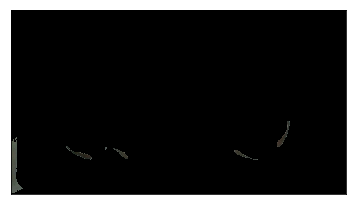

In [0]:
from matplotlib import pyplot as plt
plt.imshow(output)
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()

In [0]:
cv2.imwrite('output.png',output)

True

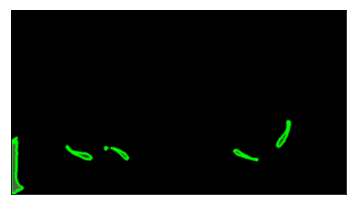

In [0]:
import numpy as np
import cv2

im = cv2.imread('/content/output.png')
imgray = cv2.cvtColor(im,cv2.COLOR_BGR2GRAY)
ret,thresh = cv2.threshold(imgray,100,100,100)
image, contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)

#print(contours)
img = cv2.drawContours(im, contours, -1, (0,255,0), 3)
plt.imshow(im, cmap = 'gray', interpolation = 'bicubic')
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()

426 268 45 20
194 265 30 22
191 264 2 1
179 263 6 5
106 260 48 27
0 244 23 107
508 213 25 50


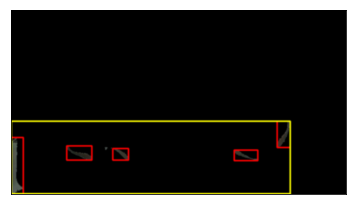

In [0]:
im = cv2.imread('/content/output.png')

canny_img = im
#im2, contours, hierarchy = cv2.findContours(canny_img,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
im2, contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)


try: hierarchy = hierarchy[0]
except: hierarchy = []

height, width, _ = canny_img.shape
min_x, min_y = width, height
max_x = max_y = 0

# computes the bounding box for the contour, and draws it on the frame,
for contour, hier in zip(contours, hierarchy):
    (x,y,w,h) = cv2.boundingRect(contour)
    print(x,y,w,h)
    min_x, max_x = min(x, min_x), max(x+w, max_x)
    min_y, max_y = min(y, min_y), max(y+h, max_y)
    if w > 5 and h > 5:
        cv2.rectangle(canny_img, (x,y), (x+w,y+h), (255, 0, 0), 2)

if max_x - min_x > 10 and max_y - min_y > 10:
  
    cv2.rectangle(canny_img, (min_x, min_y), (max_x, max_y), (255, 255, 0), 2)
    
plt.imshow(canny_img, cmap = 'gray', interpolation = 'bicubic')
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()

In [0]:
import cv2
import numpy as np
 
img = cv2.imread('/content/output.png',0)
ret,thresh = cv2.threshold(imgray,100,100,100)
image, contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
 
cnt = contours[0]
M = cv2.moments(cnt)
print(M)

{'m00': 147.0, 'm10': 64725.0, 'm01': 40590.5, 'm20': 28514824.166666664, 'm11': 17878883.583333332, 'm02': 11211248.666666666, 'm30': 12569528877.5, 'm21': 7879588579.083333, 'm12': 4940067796.083333, 'm03': 3097467610.25, 'mu20': 16010.39115646109, 'mu11': 6637.920068029314, 'mu02': 3162.3384353742003, 'mu30': 178269.86256027222, 'mu21': 63075.07047788799, 'mu12': 20565.205492915353, 'mu03': 5632.012888431549, 'nu20': 0.7409130990078712, 'nu11': 0.3071831212934108, 'nu02': 0.14634358070129114, 'nu30': 0.6804317852850382, 'nu21': 0.24074895327716123, 'nu12': 0.07849458841405134, 'nu03': 0.0214966261228152}


In [0]:
cx = int(M['m10']/M['m00'])
cy = int(M['m01']/M['m00'])

In [0]:
 area = cv2.contourArea(cnt)

In [0]:
perimeter = cv2.arcLength(cnt,True)

In [0]:
k = cv2.isContourConvex(cnt)
x,y,w,h = cv2.boundingRect(cnt)
cv2.rectangle(img,(x,y),(x+w,y+h),(0,255,0),2)

array([[ 0,  0,  0, ...,  0,  0,  0],
       [ 0,  0,  0, ...,  0,  0,  0],
       [ 0,  0,  0, ...,  0,  0,  0],
       ...,
       [93, 93, 93, ...,  0,  0,  0],
       [ 0,  0, 96, ...,  0,  0,  0],
       [ 0,  0,  0, ...,  0,  0,  0]], dtype=uint8)

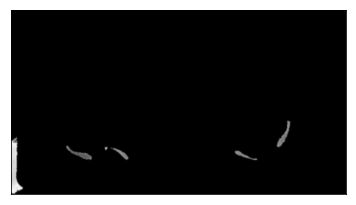

In [0]:
#img = cv2.drawContours(im, contours, -1, (0,255,0), 3)
plt.imshow(img, cmap = 'gray', interpolation = 'bicubic')
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()

In [0]:
rect = cv2.minAreaRect(cnt)
box = cv2.boxPoints(rect)
box = np.int0(box)
cv2.drawContours(img,[box],0,(0,0,255),2)

array([[ 0,  0,  0, ...,  0,  0,  0],
       [ 0,  0,  0, ...,  0,  0,  0],
       [ 0,  0,  0, ...,  0,  0,  0],
       ...,
       [93, 93, 93, ...,  0,  0,  0],
       [ 0,  0, 96, ...,  0,  0,  0],
       [ 0,  0,  0, ...,  0,  0,  0]], dtype=uint8)

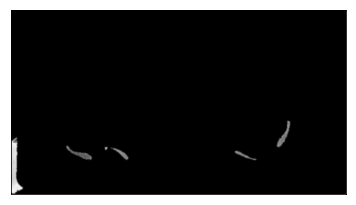

In [0]:
#img = cv2.drawContours(im, contours, -1, (0,255,0), 3)
plt.imshow(img, cmap = 'gray', interpolation = 'bicubic')
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()

In [0]:
from google.colab import files
files.upload()

{'VID-20190705-WA0006.zip': b'PK\x03\x04\x14\x00\x00\x00\x08\x00\xcdX\xe5Nu\x07f\xd1\xd4\xd3a\x005\xeca\x00\x17\x00\x00\x00VID-20190705-WA0006.mp4\x8cY\ttTe\x96\xbe\x95=!\xcb\xab$U\xd9\x93\xcaB\x02"\x18\x16\x11\xda\x00\x85\xa8\x80 D\x11YDL \x11\x90D"\x01\x9cF\x9d\x89\x8e=\x82\xad\xc7\xb4\xe36\xda\xb6i\xd7Q\xe9\x9e:\x0e\x1e\x01\xbb\xa7k\xfa\xa8}\xda\x9en3::\xb8\x1dJ[\xd1F\x1b+\xec!\x0bs\xef\x7f\xef\xff\xde\r\xda\x9e\xa9s\xfe\xbc\xf7\xbe\xff\xfew\xbf\xf7\xff\xdf\x0b\x00\x14^\xbf\xe5\x87\x1d\xed\x1dS&\x01\xfe\xe8\xba\xa1sS;\xde\x16\xaeimn\xf7\xe1\r\r\xfa%\x98\xbf\x93\xd6\xb4o\xda\xb4\ro\xda\xda\xb7\xado\x81\x11\xbfW\xbb \xf0\xe8RZ\xe0\x03\xf5\x1b\xf1\xf0\xed\xe70|\xef/\x11 \x98\xb5es\xf3F\xbc_\xb5e\xa3\x91\x99\xaa\xe6\x99[\xe0\x81L\xbd\xc8\xe7\xcd\x9cM\xe9\xfe\xc28\x12\xba\x10n\xa2\xa7\xc0\xf3\xed-\x1b\x9a\xf1&\xd4\xder\xb6][\x1f\x83\xac\x1d\xfb\x97\xbef\x1e\xaa\xd6\xb7\xb4m\xb63\xdb6\xb4\xb4\xc2Y\xbf\xc0u\xed\x1bn\xbc\x1eo\xf2\xb7\xb5\x9f\xcd\tjZx\xae\xb4es\xeb\xf5\x82\x91^\x99[7\xb7\x85

In [0]:
!unzip /content/VID-20190705-WA0006.zip

Archive:  /content/VID-20190705-WA0006.zip
  inflating: VID-20190705-WA0006.mp4  


In [0]:
import os
os.mkdir('images')

In [0]:
import cv2 

# Function to extract frames 
def FrameCapture(path): 
	
	# Path to video file 
	vidObj = cv2.VideoCapture(path) 

	# Used as counter variable 
	count = 0

	# checks whether frames were extracted 
	success = 1

	while success: 

		# vidObj object calls read 
		# function extract frames 
		success, image = vidObj.read() 

		# Saves the frames with frame-count 
		cv2.imwrite("images/06frame%d.jpg" % count, image)
		print( count ,"done")

		count += 1
FrameCapture("VID-20190705-WA0006.mp4")

In [0]:
import os
os.mkdir('geryimages')

In [0]:
files = os.listdir('/content/images')
files[0]

'06frame765.jpg'

In [0]:
import numpy as np
import argparse
import cv2

#path ='/content/06frame60.jpg'
for i in files:
  path = '/content/images/'+i
  image = cv2.imread(path)
  #image.shape
  lower = [17, 15, 100]
  upper = [50, 56, 200]

  lower,upper = ([0,0,0], [100,100,100])

  lower = np.array(lower, dtype = "uint8")
  upper = np.array(upper, dtype = "uint8")
  mask = cv2.inRange(image, lower, upper)
  output = cv2.bitwise_and(image, image, mask = mask)
  cv2.imwrite('/content/geryimages/'+'grey'+i,output)
  print(i)

In [0]:
import os
os.listdir('/content/geryimages')

In [0]:
from google.colab import files
files.download('/content/geryimages/grey06frame97.jpg')

In [0]:
grey = os.listdir('/content/geryimages')

In [0]:
os.mkdir('contours')

In [0]:
import matplotlib.pyplot as plt

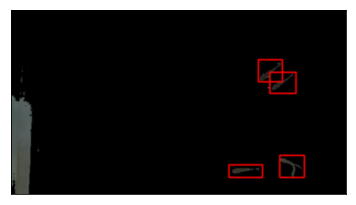

0 done


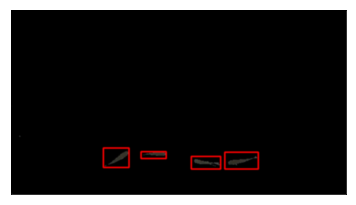

1 done


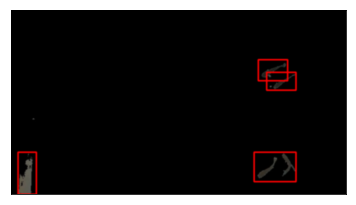

2 done


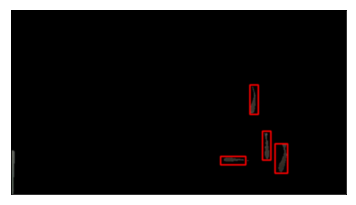

3 done


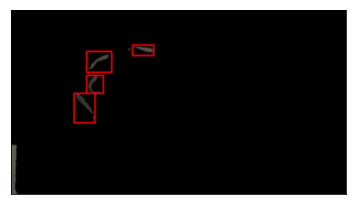

4 done


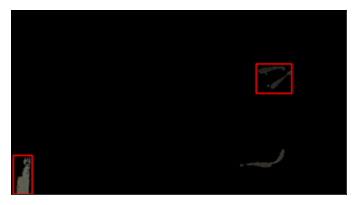

5 done


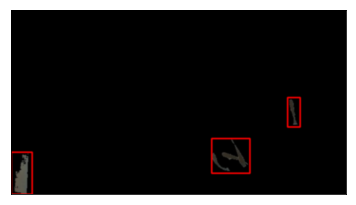

6 done


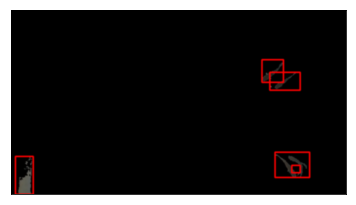

7 done


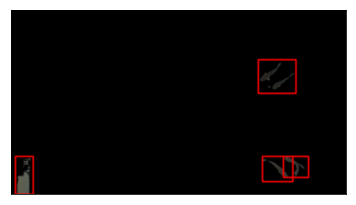

8 done


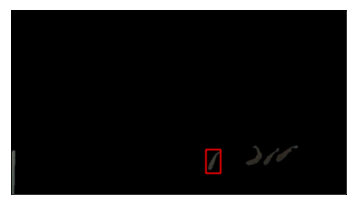

9 done


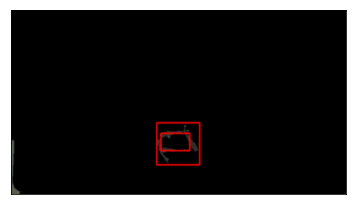

10 done


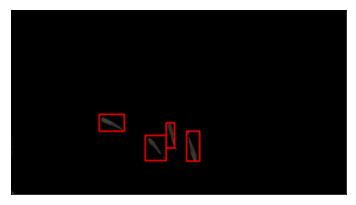

11 done


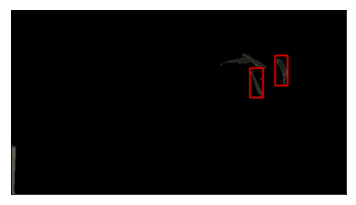

12 done


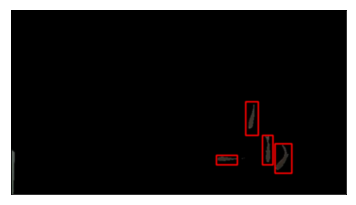

13 done


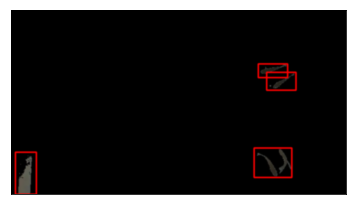

14 done


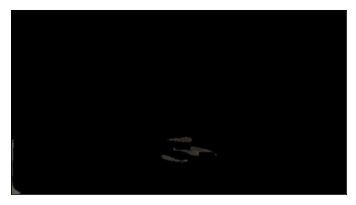

15 done


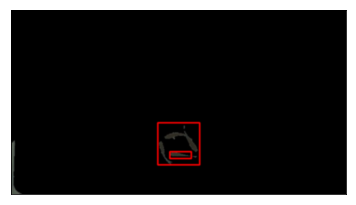

16 done


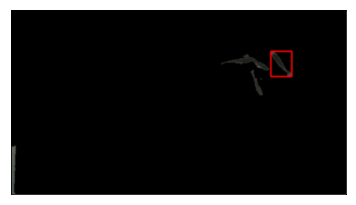

17 done


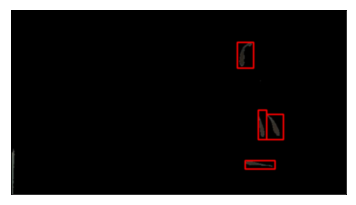

18 done


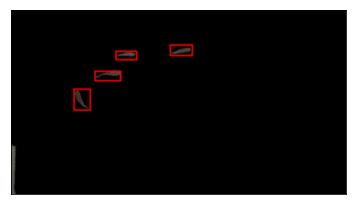

19 done


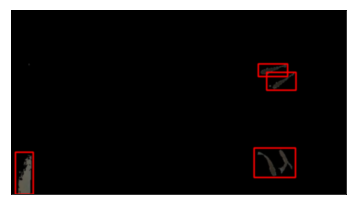

20 done


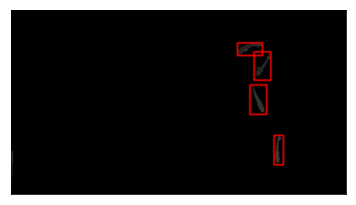

21 done


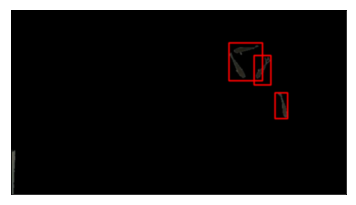

22 done


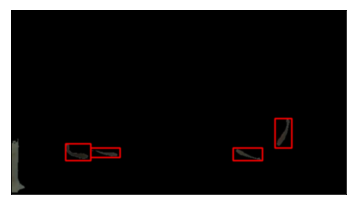

23 done


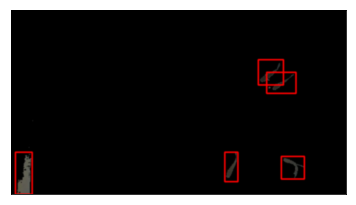

24 done


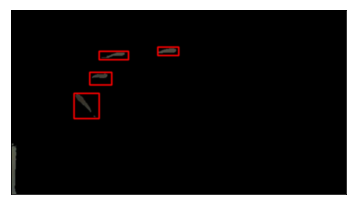

25 done


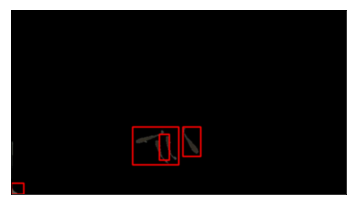

26 done


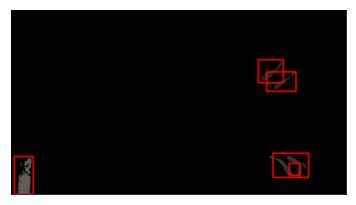

27 done


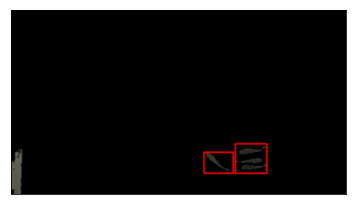

28 done


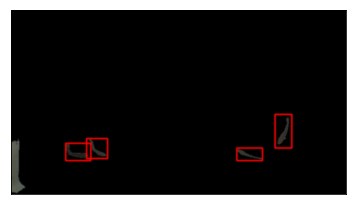

29 done


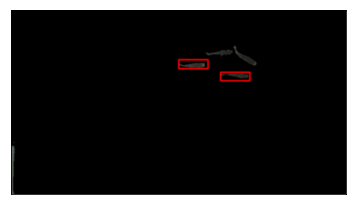

30 done


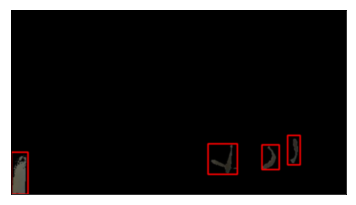

31 done


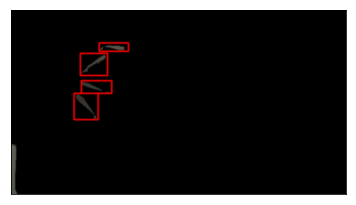

32 done


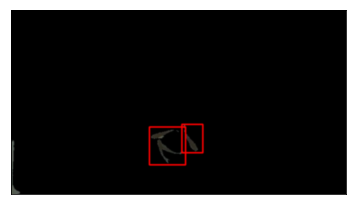

33 done


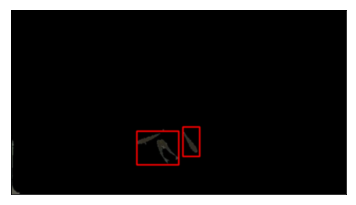

34 done


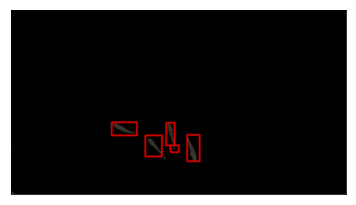

35 done


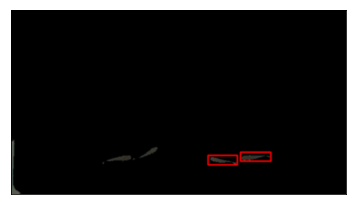

36 done


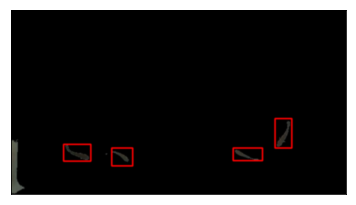

37 done


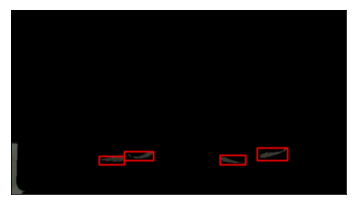

38 done


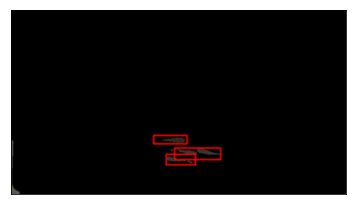

39 done


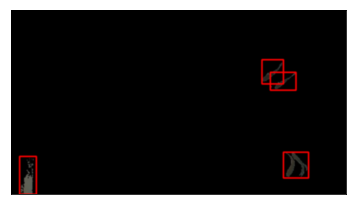

40 done


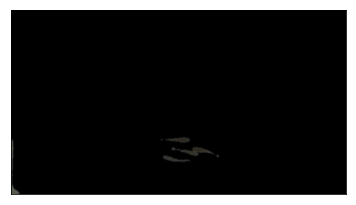

41 done


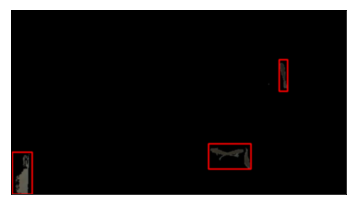

42 done


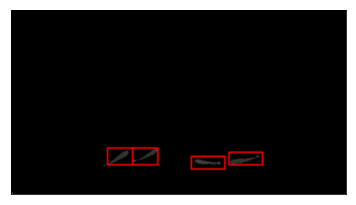

43 done


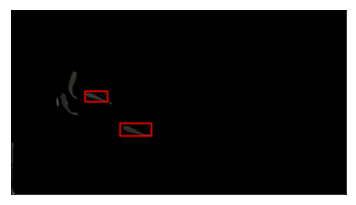

44 done


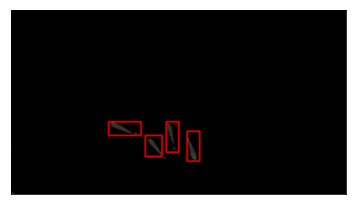

45 done


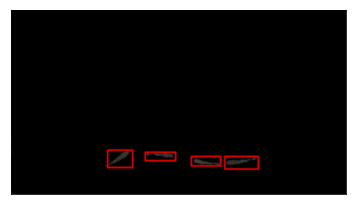

46 done


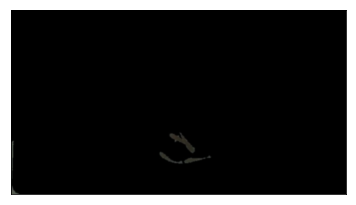

47 done


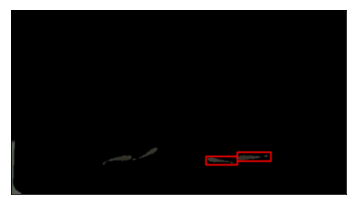

48 done


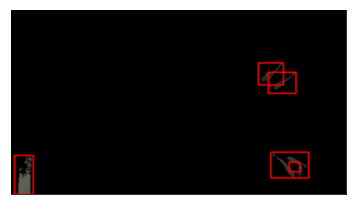

49 done


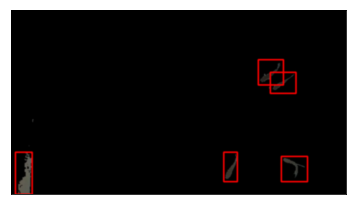

50 done


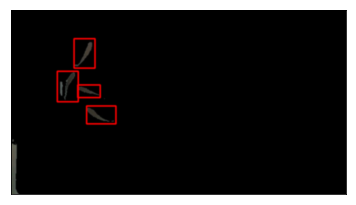

51 done


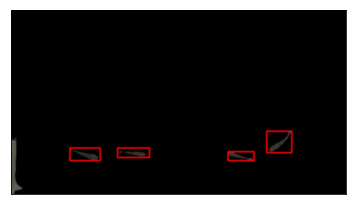

52 done


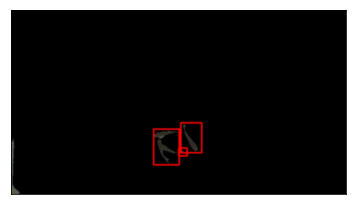

53 done


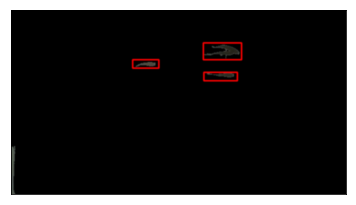

54 done


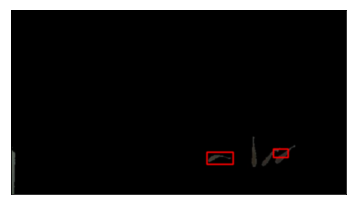

55 done


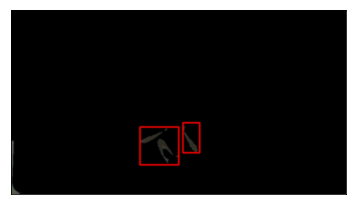

56 done


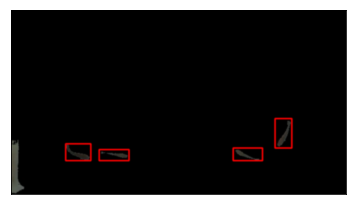

57 done


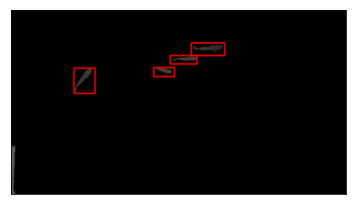

58 done


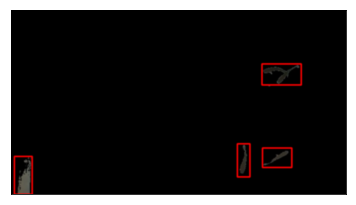

59 done


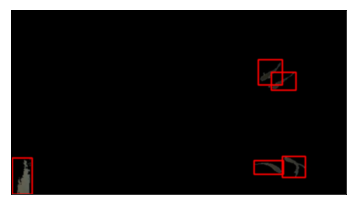

60 done


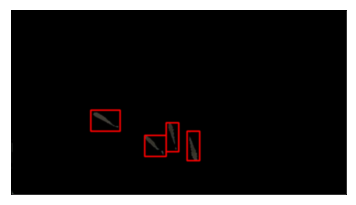

61 done


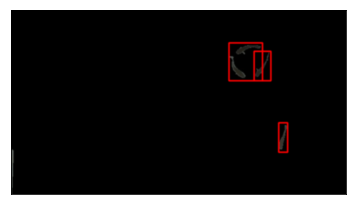

62 done


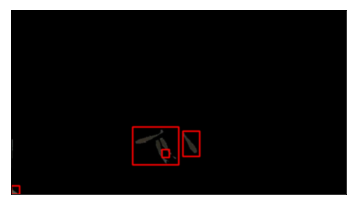

63 done


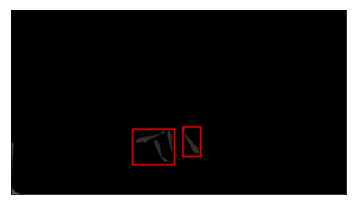

64 done


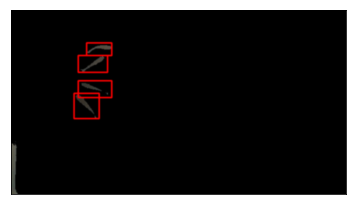

65 done


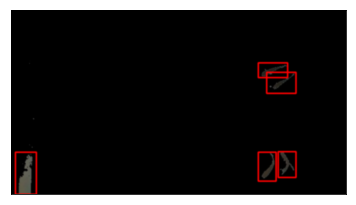

66 done


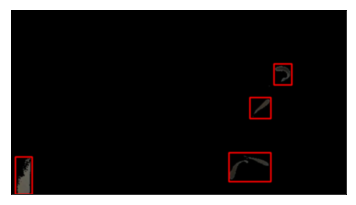

67 done


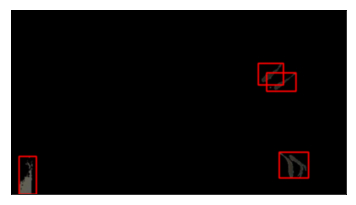

68 done


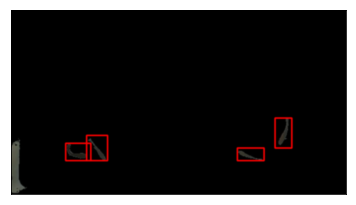

69 done


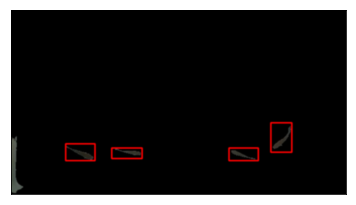

70 done


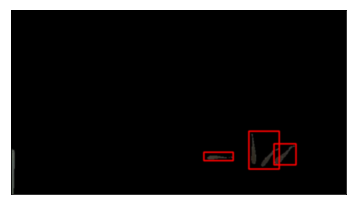

71 done


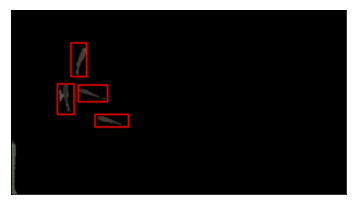

72 done


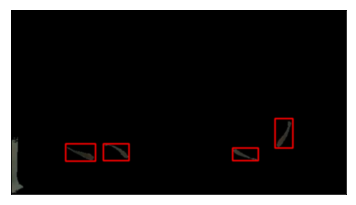

73 done


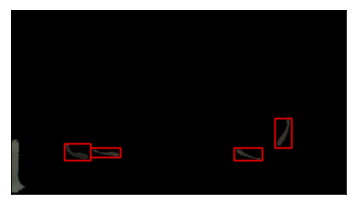

74 done


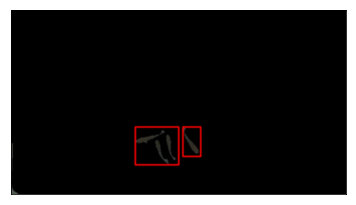

75 done


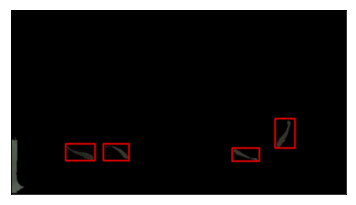

76 done


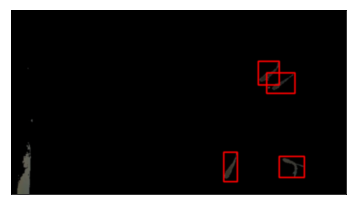

77 done


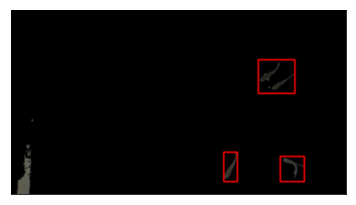

78 done


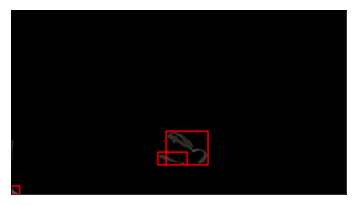

79 done


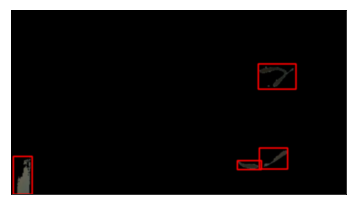

80 done


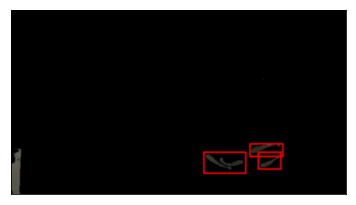

81 done


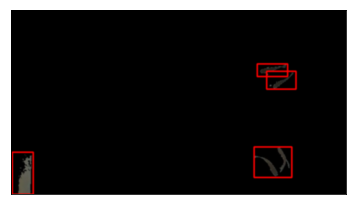

82 done


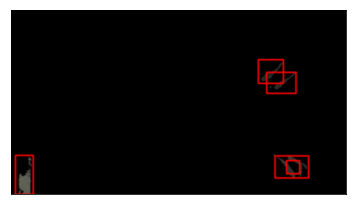

83 done


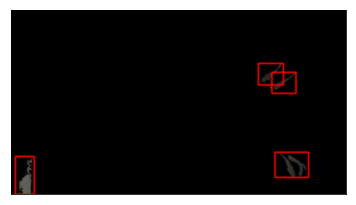

84 done


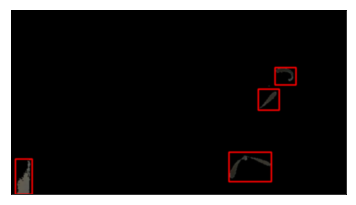

85 done


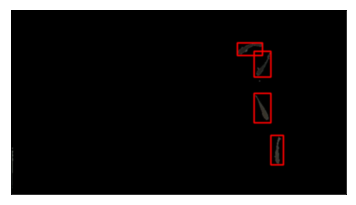

86 done


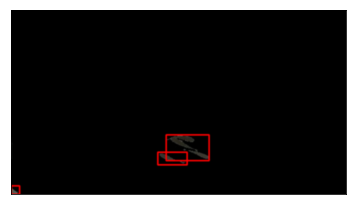

87 done


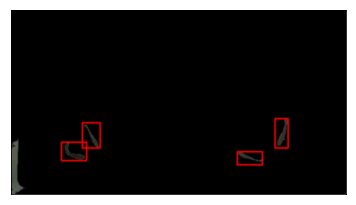

88 done


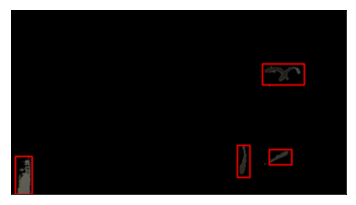

89 done


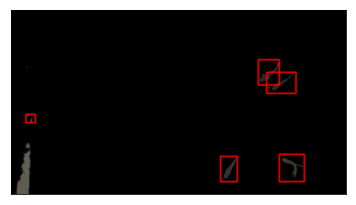

90 done


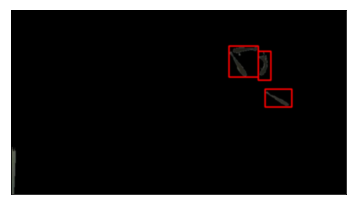

91 done


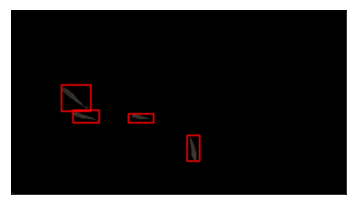

92 done


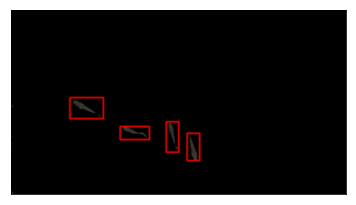

93 done


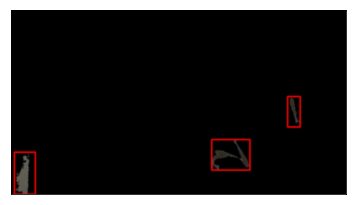

94 done


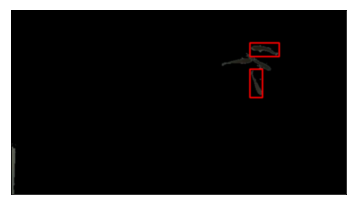

95 done


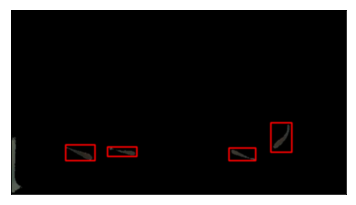

96 done


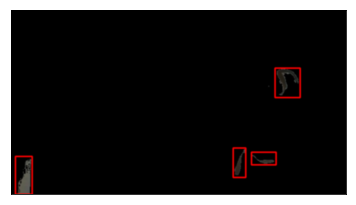

97 done


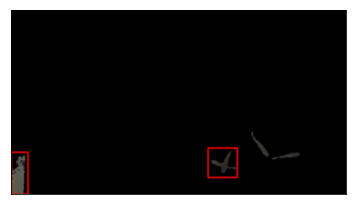

98 done


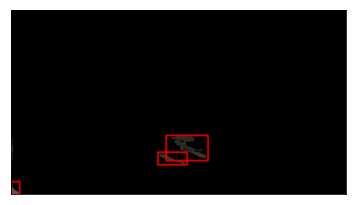

99 done


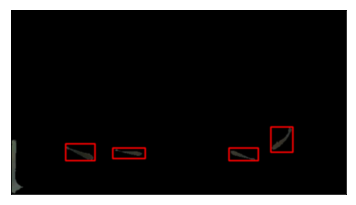

100 done


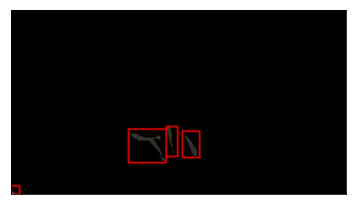

101 done


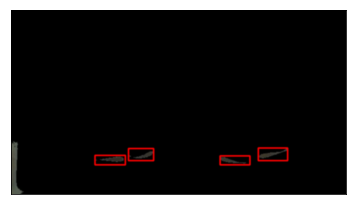

102 done


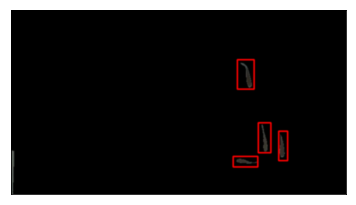

103 done


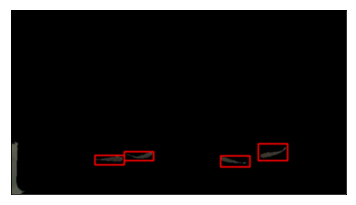

104 done


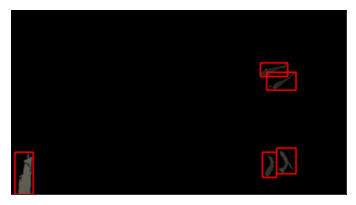

105 done


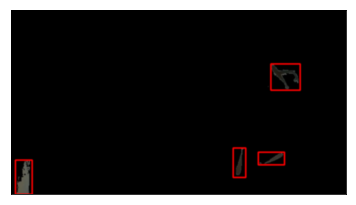

106 done


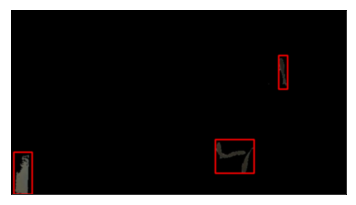

107 done


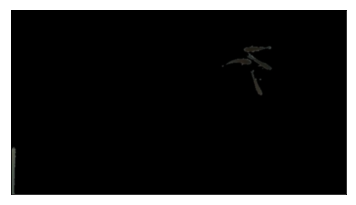

108 done


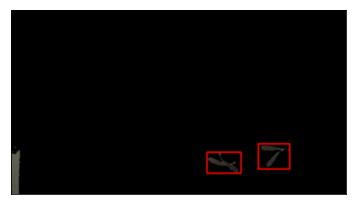

109 done


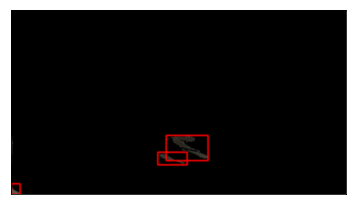

110 done


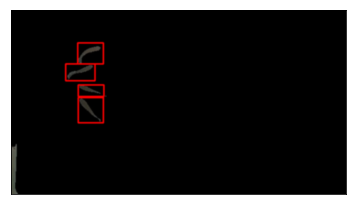

111 done


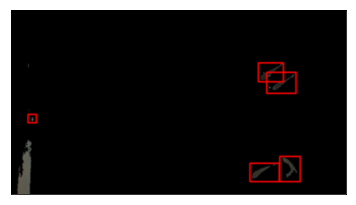

112 done


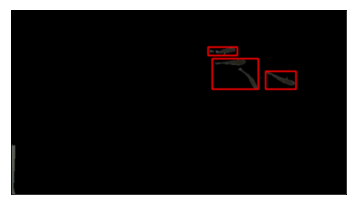

113 done


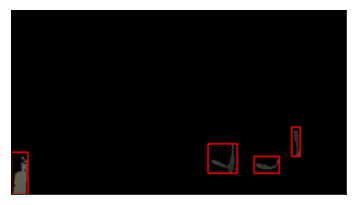

114 done


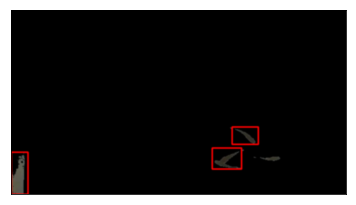

115 done


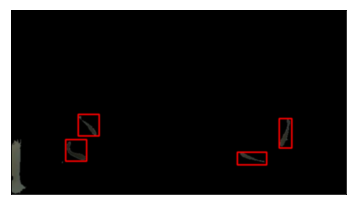

116 done


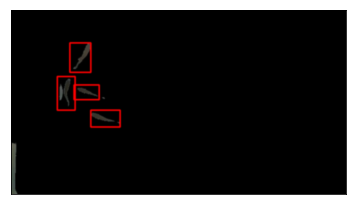

117 done


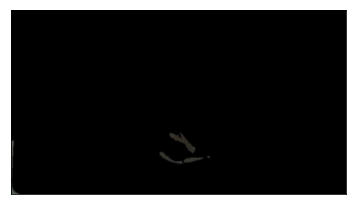

118 done


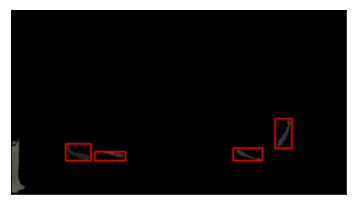

119 done


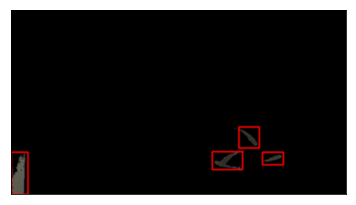

120 done


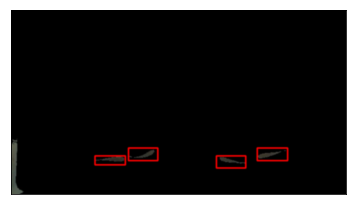

121 done


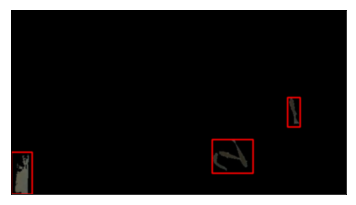

122 done


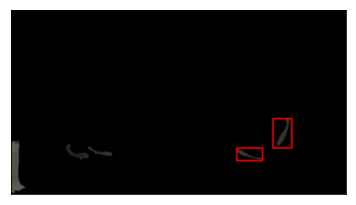

123 done


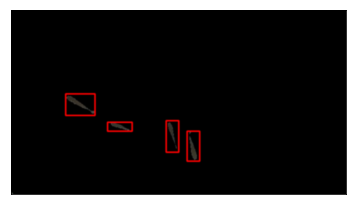

124 done


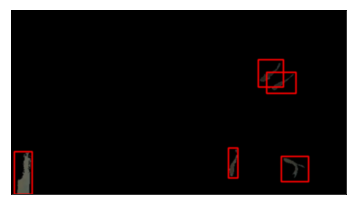

125 done


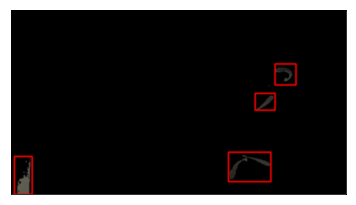

126 done


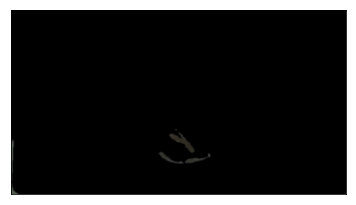

127 done


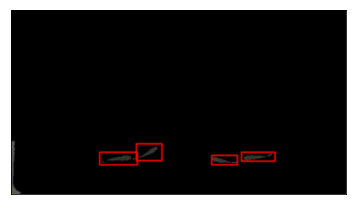

128 done


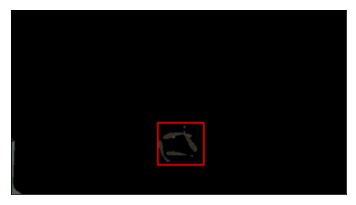

129 done


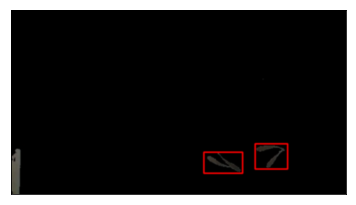

130 done


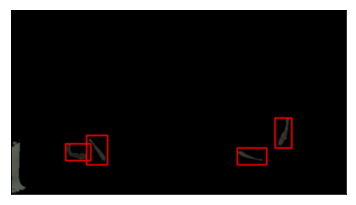

131 done


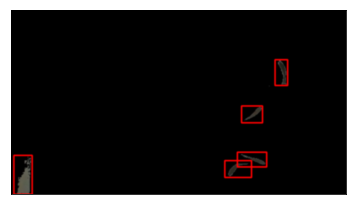

132 done


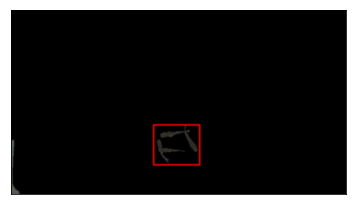

133 done


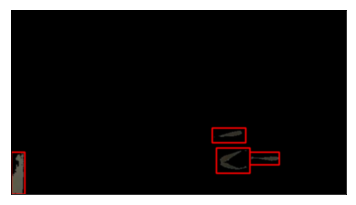

134 done


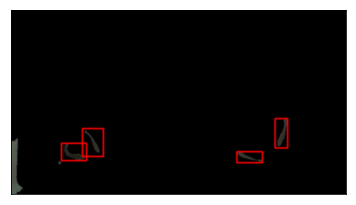

135 done


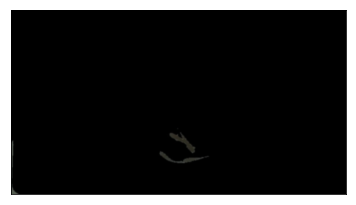

136 done


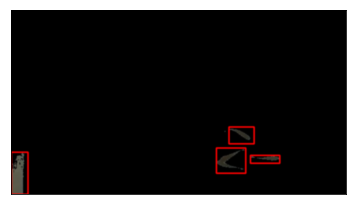

137 done


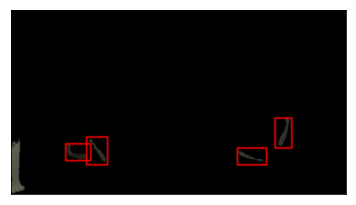

138 done


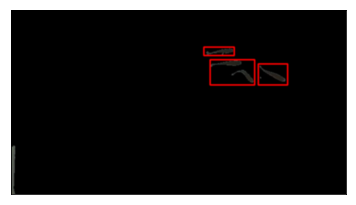

139 done


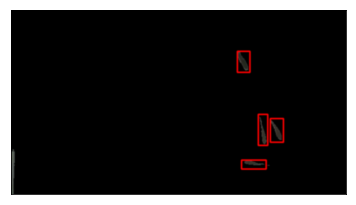

140 done


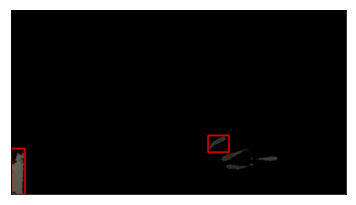

141 done


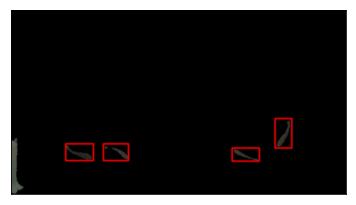

142 done


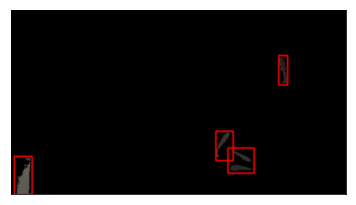

143 done


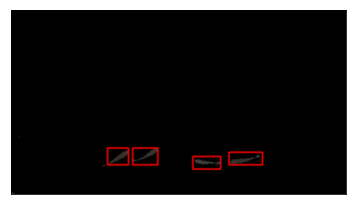

144 done


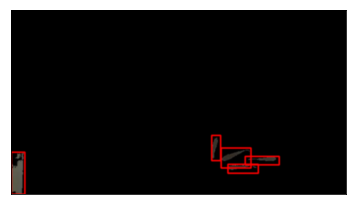

145 done


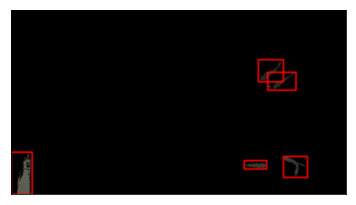

146 done


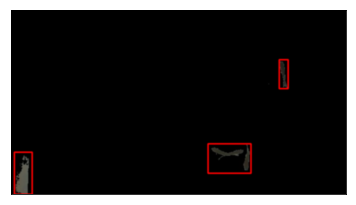

147 done


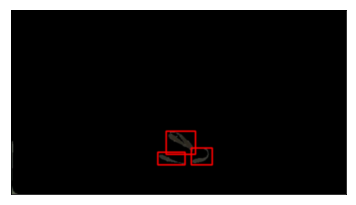

148 done


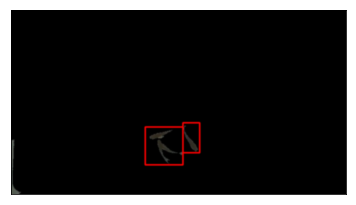

149 done


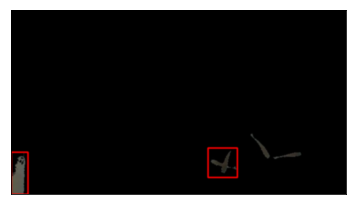

150 done


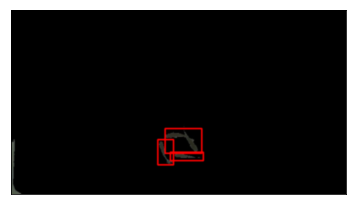

151 done


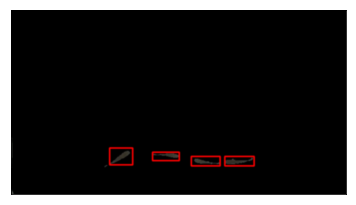

152 done


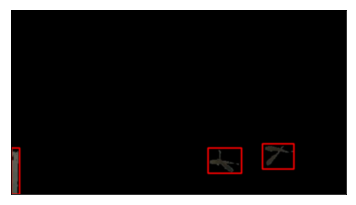

153 done


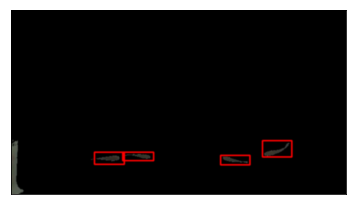

154 done


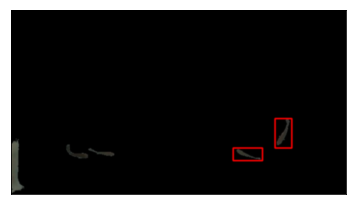

155 done


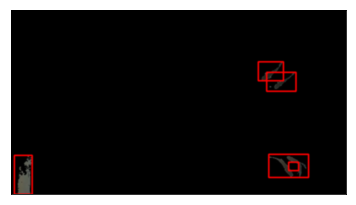

156 done


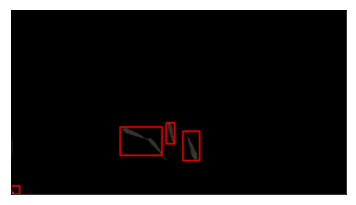

157 done


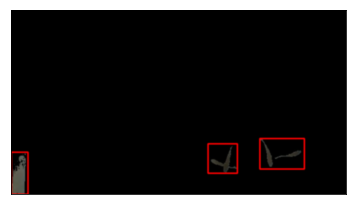

158 done


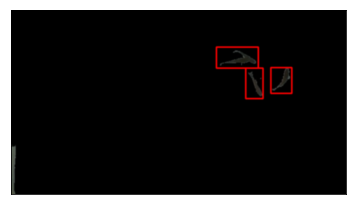

159 done


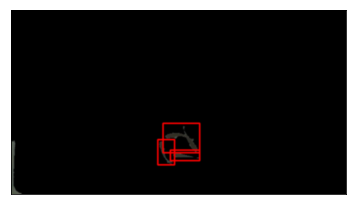

160 done


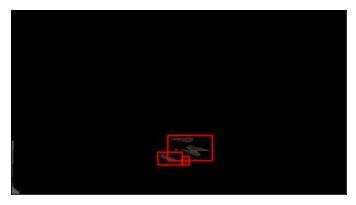

161 done


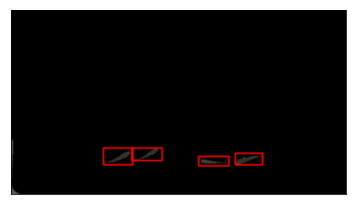

162 done


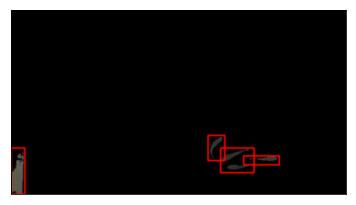

163 done


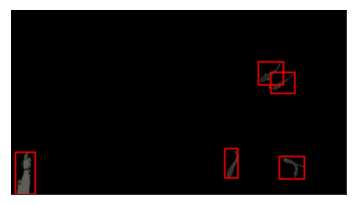

164 done


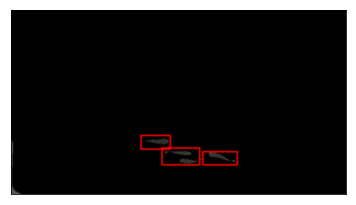

165 done


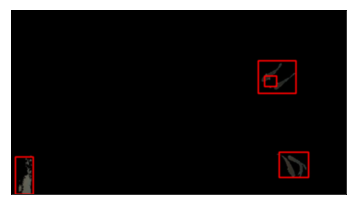

166 done


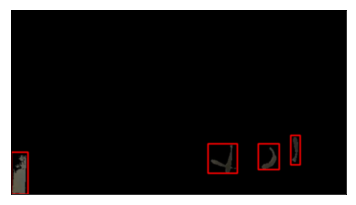

167 done


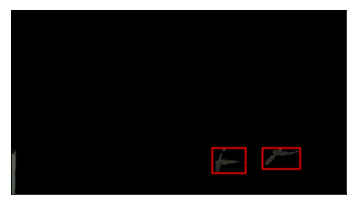

168 done


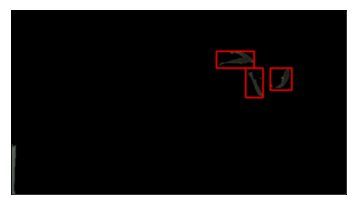

169 done


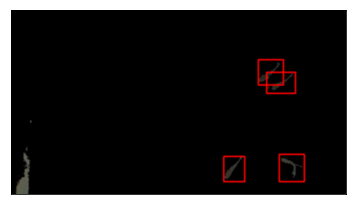

170 done


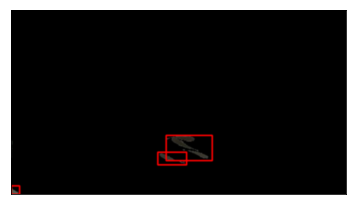

171 done


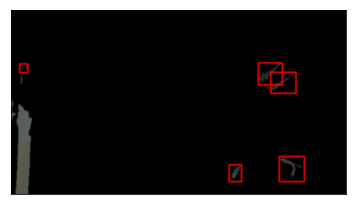

172 done


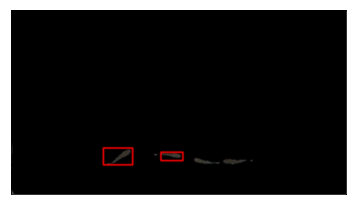

173 done


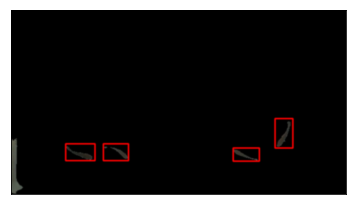

174 done


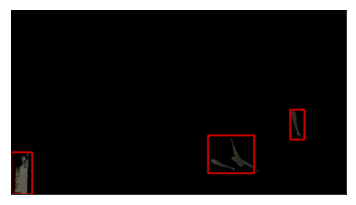

175 done


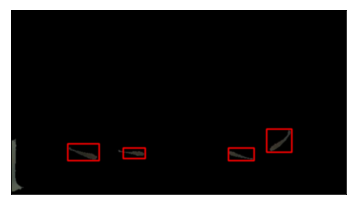

176 done


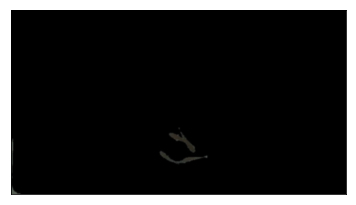

177 done


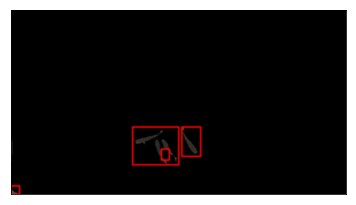

178 done


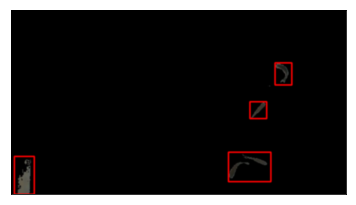

179 done


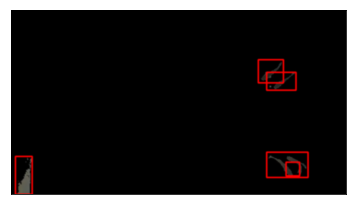

180 done


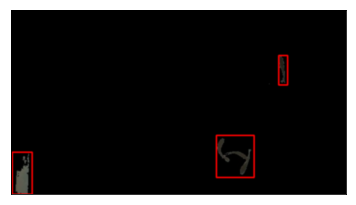

181 done


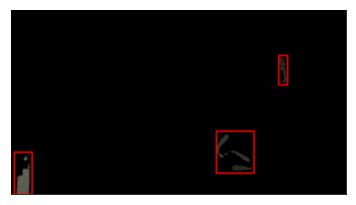

182 done


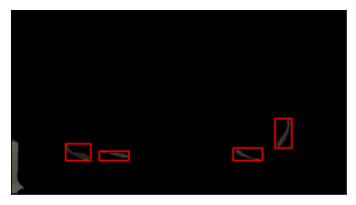

183 done


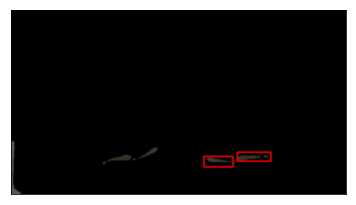

184 done


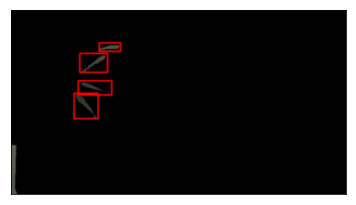

185 done


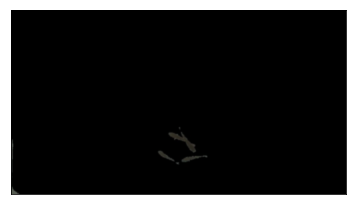

186 done


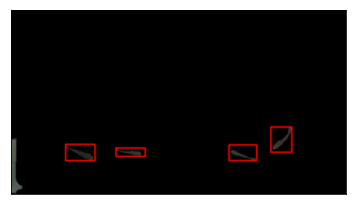

187 done


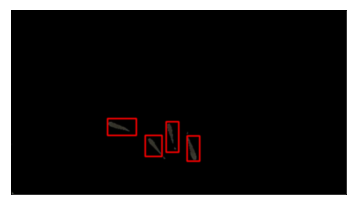

188 done


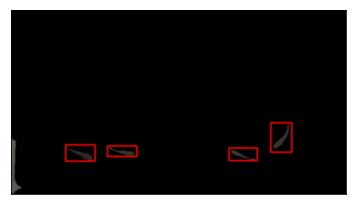

189 done


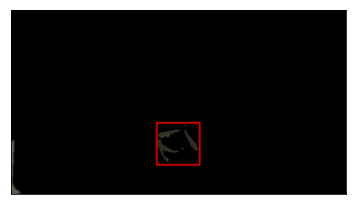

190 done


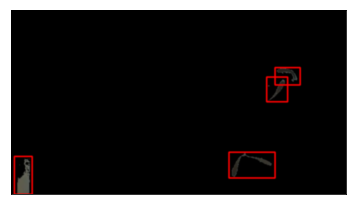

191 done


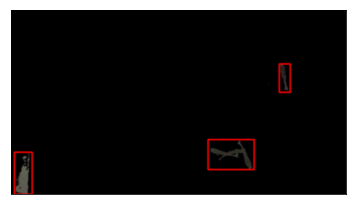

192 done


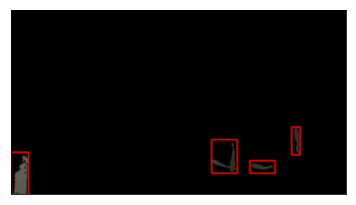

193 done


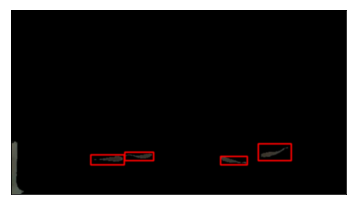

194 done


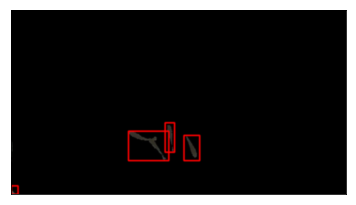

195 done


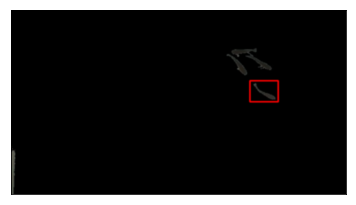

196 done


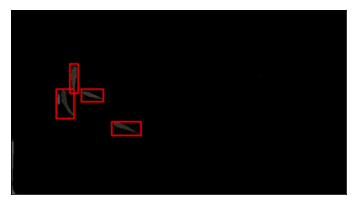

197 done


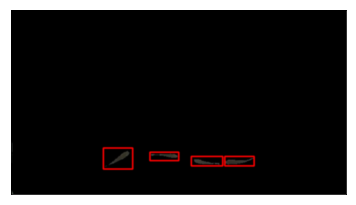

198 done


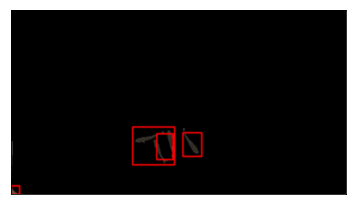

199 done


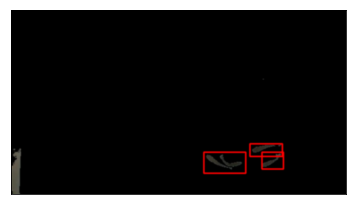

200 done


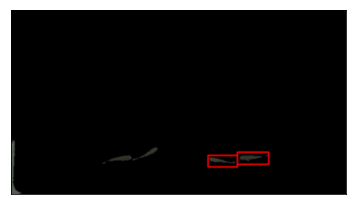

201 done


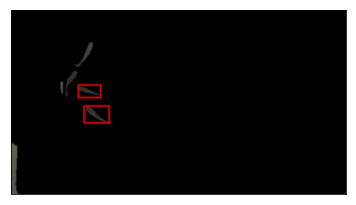

202 done


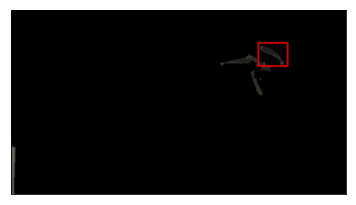

203 done


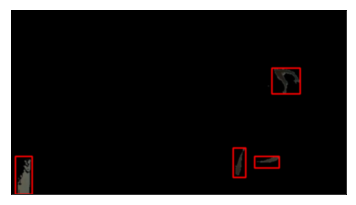

204 done


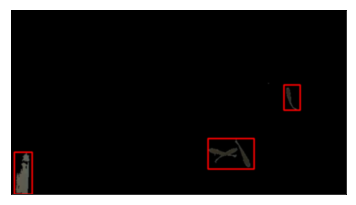

205 done


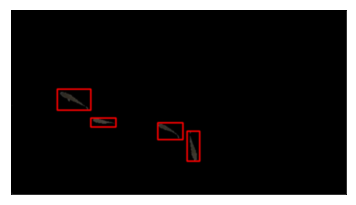

206 done


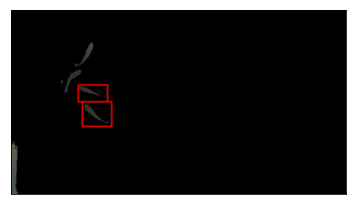

207 done


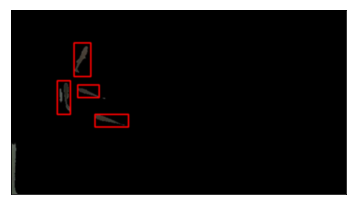

208 done


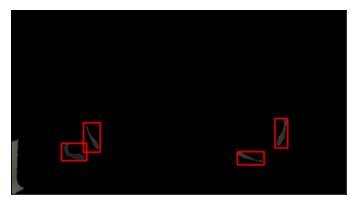

209 done


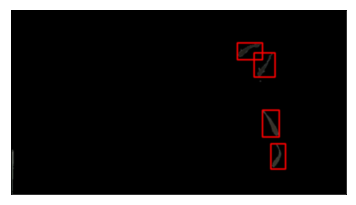

210 done


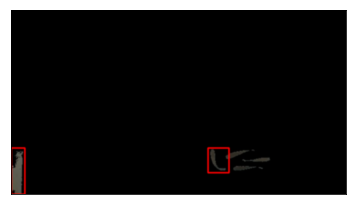

211 done


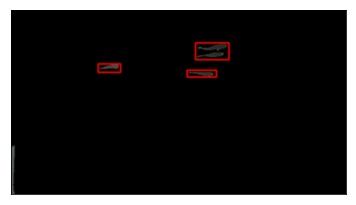

212 done


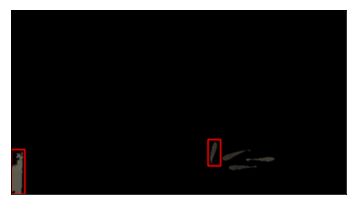

213 done


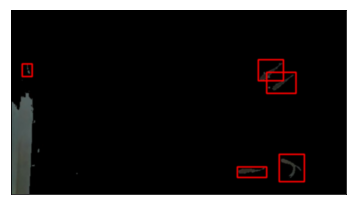

214 done


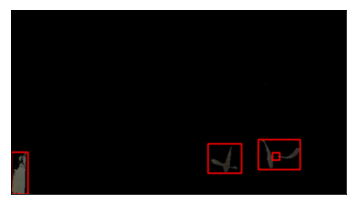

215 done


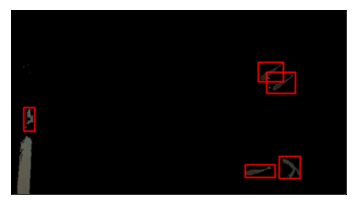

216 done


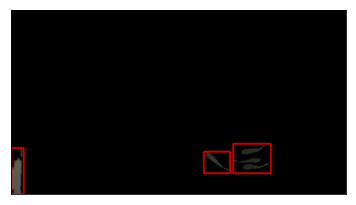

217 done


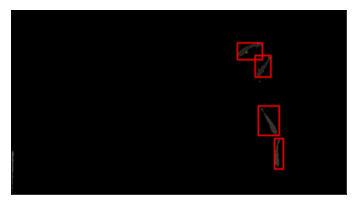

218 done


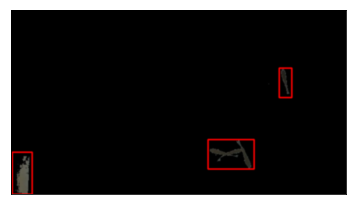

219 done


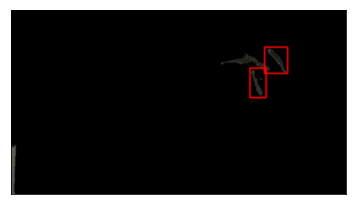

220 done


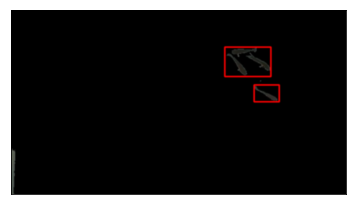

221 done


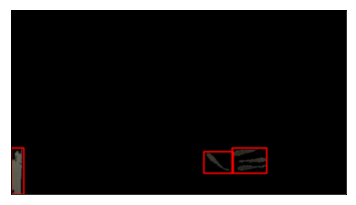

222 done


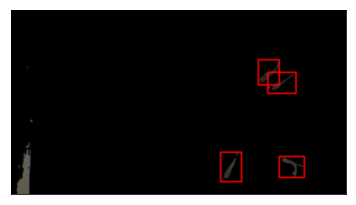

223 done


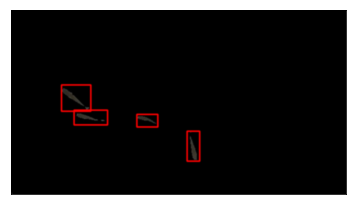

224 done


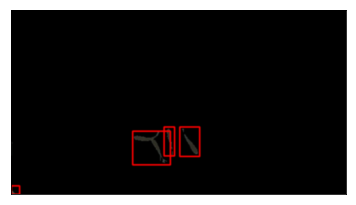

225 done


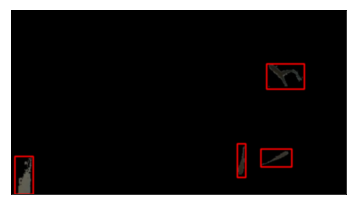

226 done


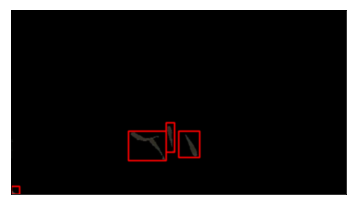

227 done


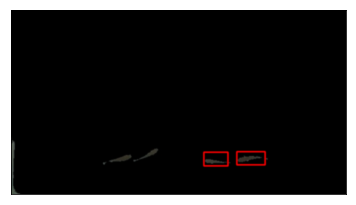

228 done


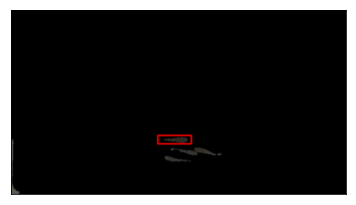

229 done


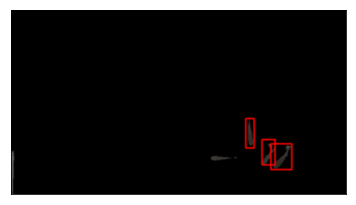

230 done


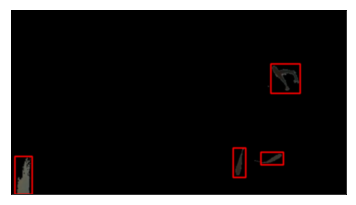

231 done


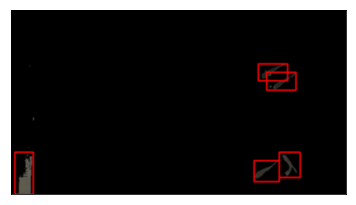

232 done


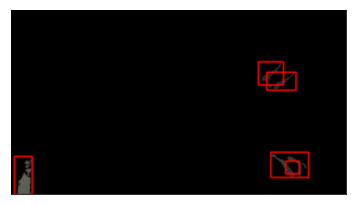

233 done


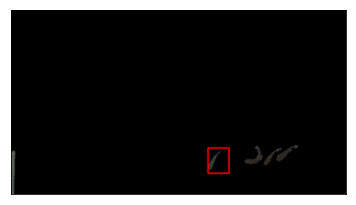

234 done


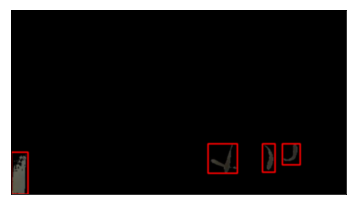

235 done


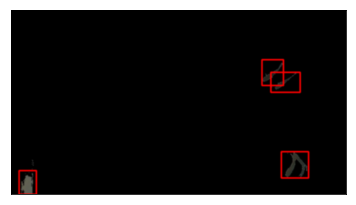

236 done


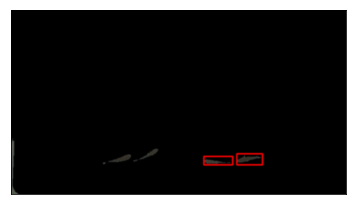

237 done


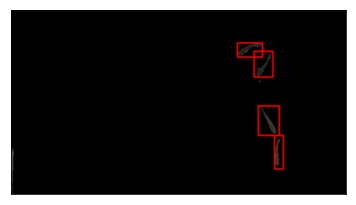

238 done


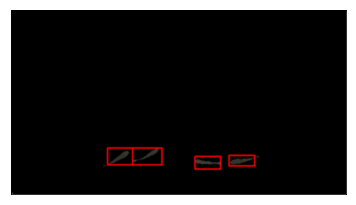

239 done


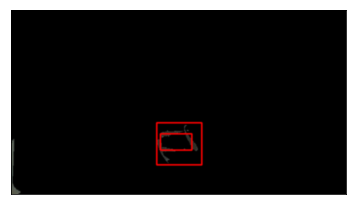

240 done


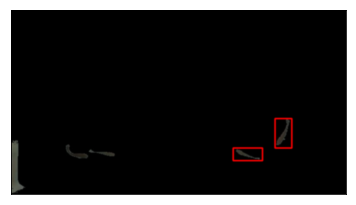

241 done


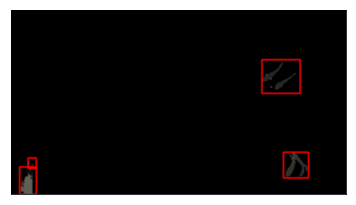

242 done


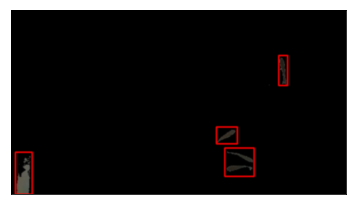

243 done


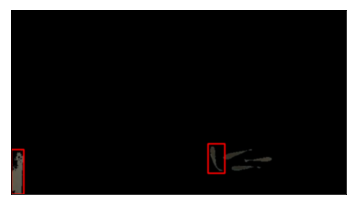

244 done


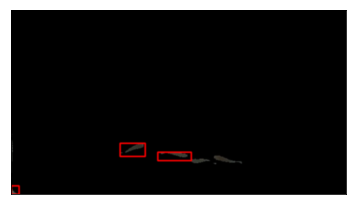

245 done


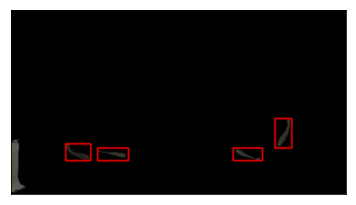

246 done


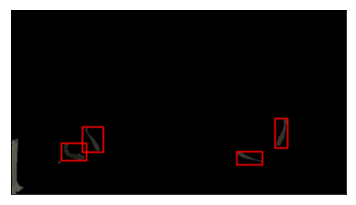

247 done


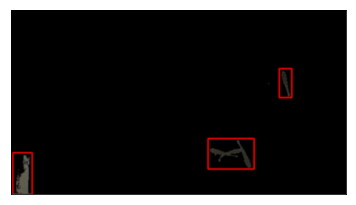

248 done


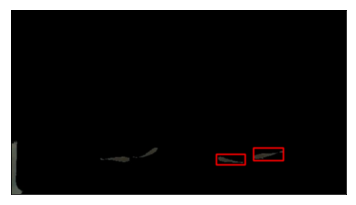

249 done


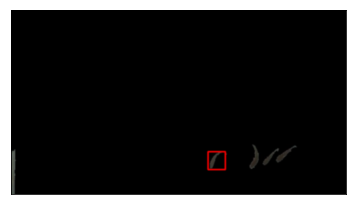

250 done


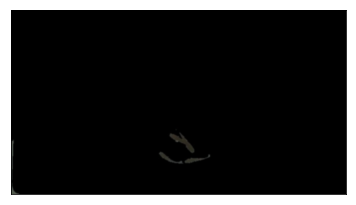

251 done


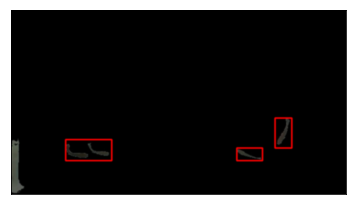

252 done


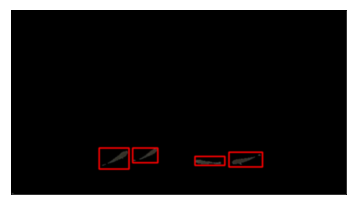

253 done


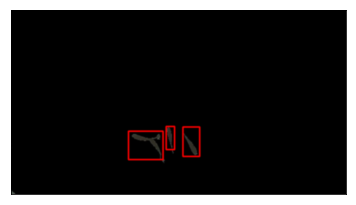

254 done


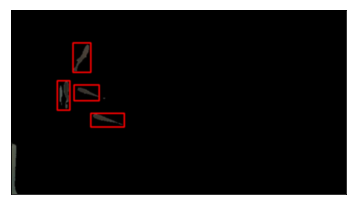

255 done


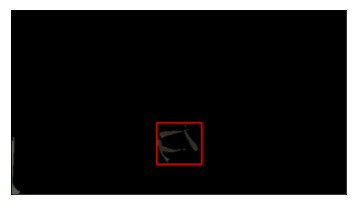

256 done


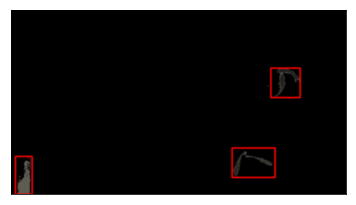

257 done


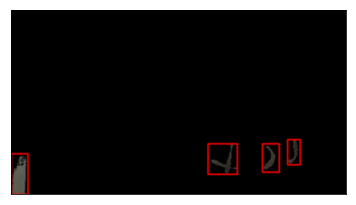

258 done


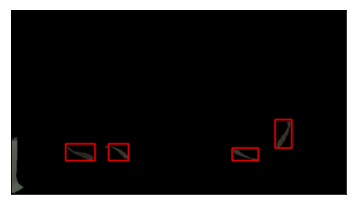

259 done


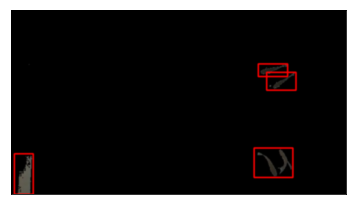

260 done


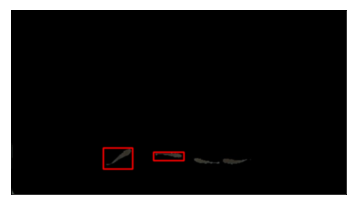

261 done


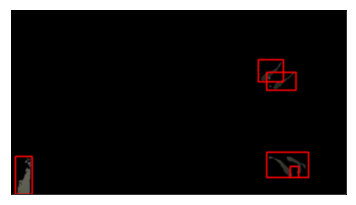

262 done


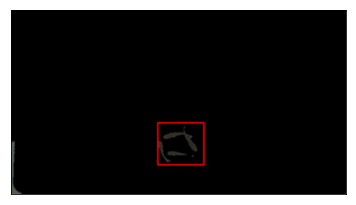

263 done


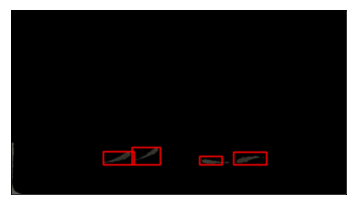

264 done


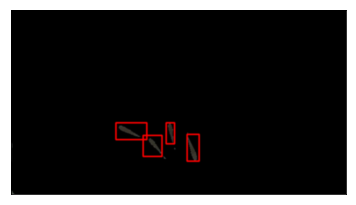

265 done


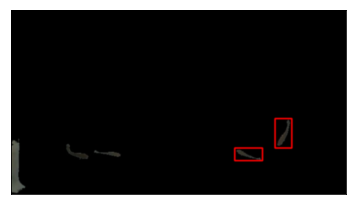

266 done


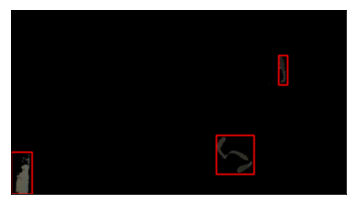

267 done


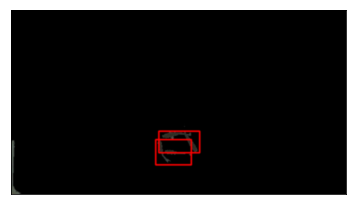

268 done


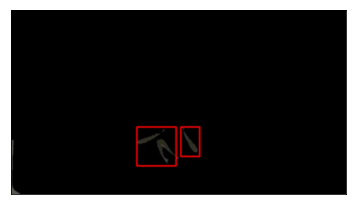

269 done


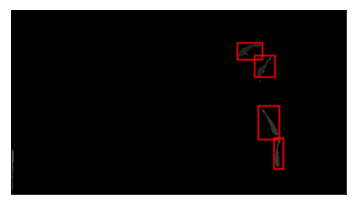

270 done


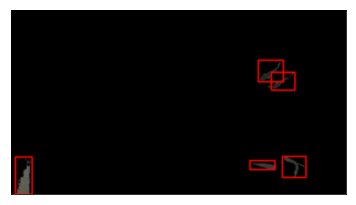

271 done


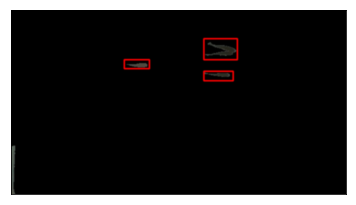

272 done


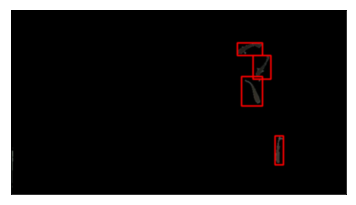

273 done


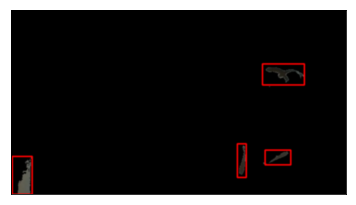

274 done


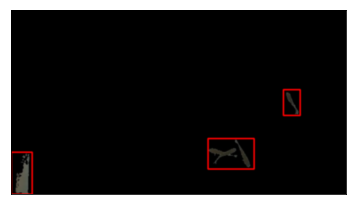

275 done


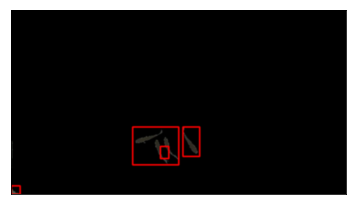

276 done


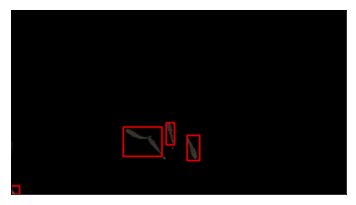

277 done


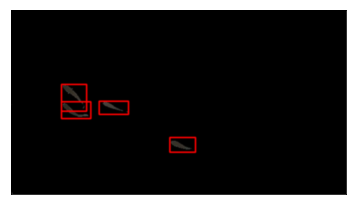

278 done


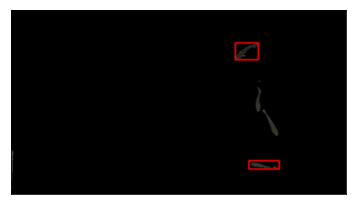

279 done


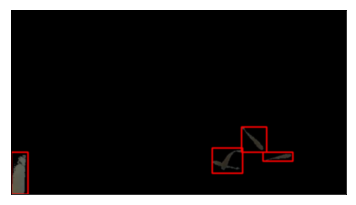

280 done


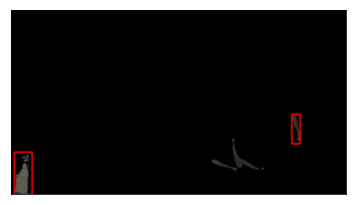

281 done


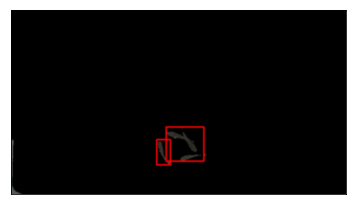

282 done


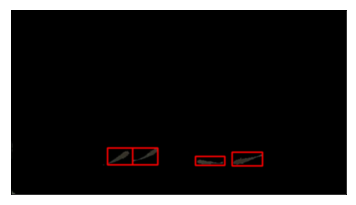

283 done


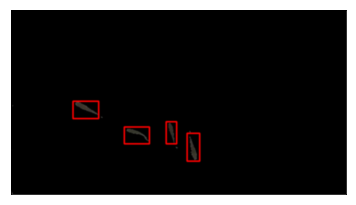

284 done


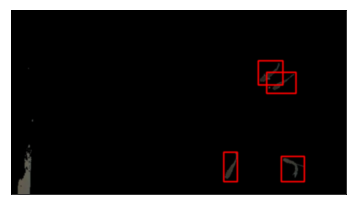

285 done


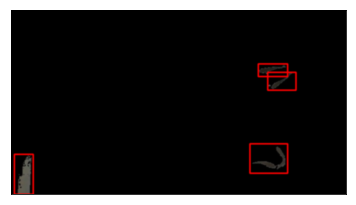

286 done


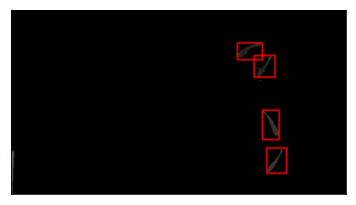

287 done


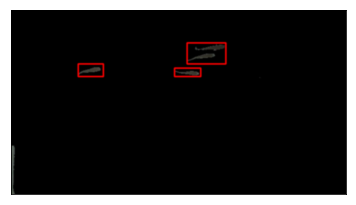

288 done


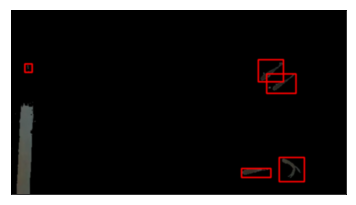

289 done


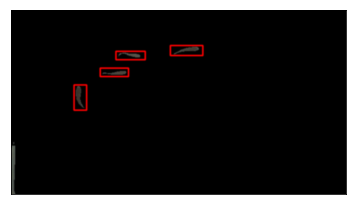

290 done


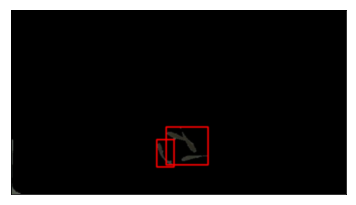

291 done


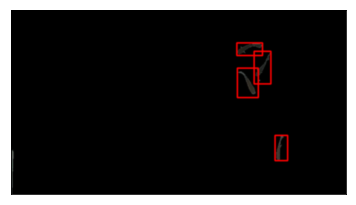

292 done


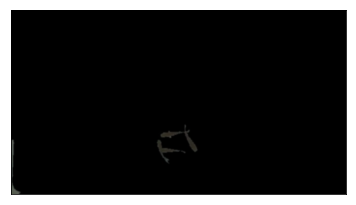

293 done


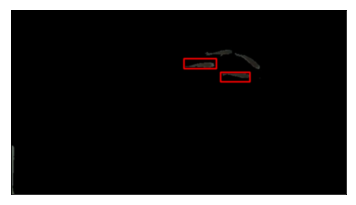

294 done


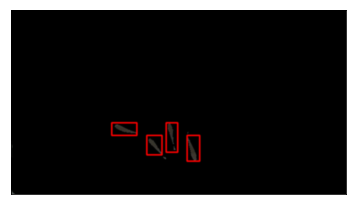

295 done


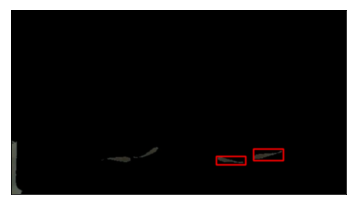

296 done


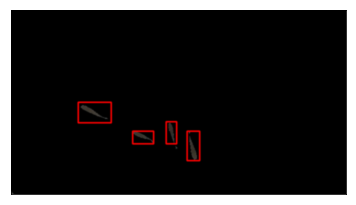

297 done


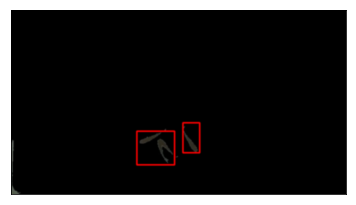

298 done


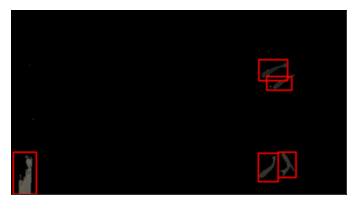

299 done


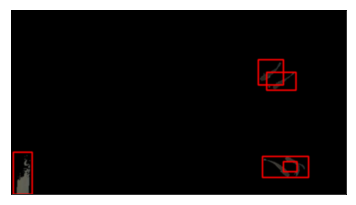

300 done


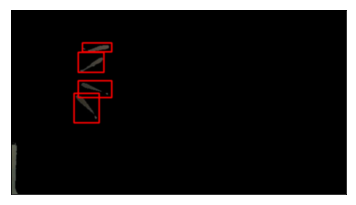

301 done


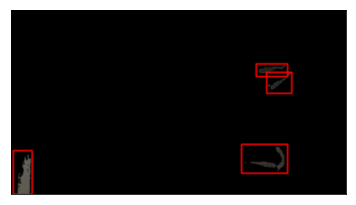

302 done


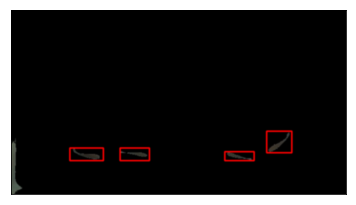

303 done


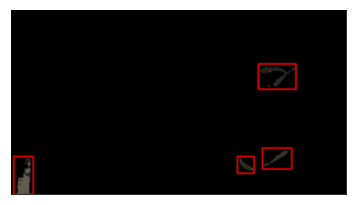

304 done


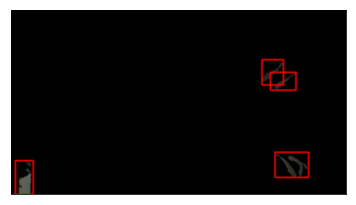

305 done


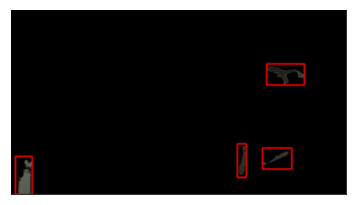

306 done


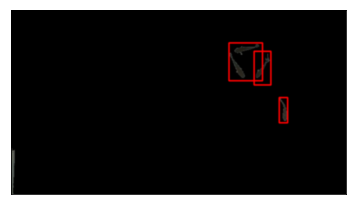

307 done


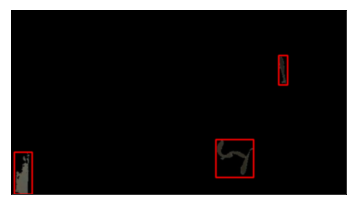

308 done


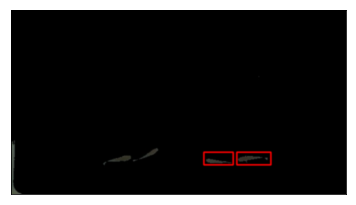

309 done


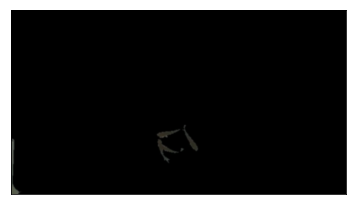

310 done


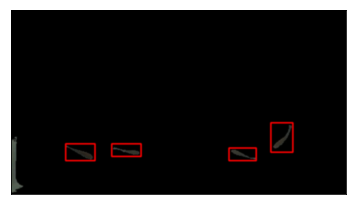

311 done


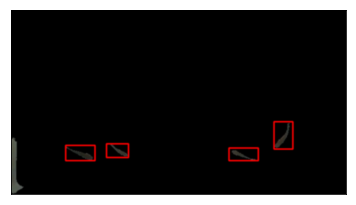

312 done


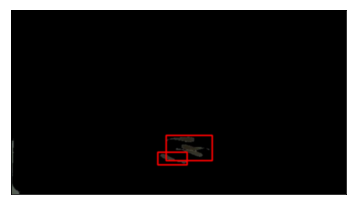

313 done


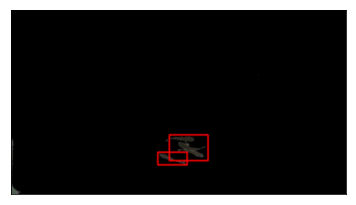

314 done


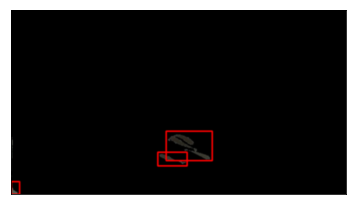

315 done


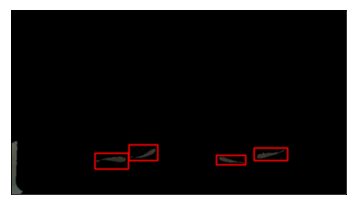

316 done


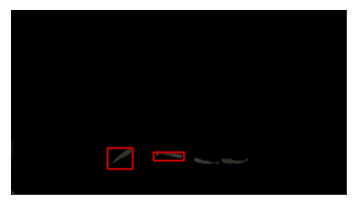

317 done


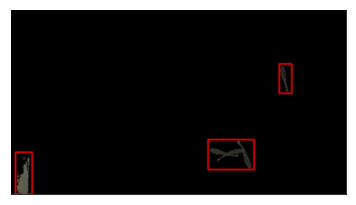

318 done


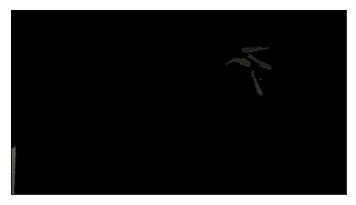

319 done


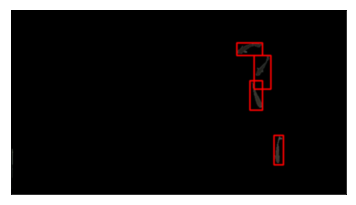

320 done


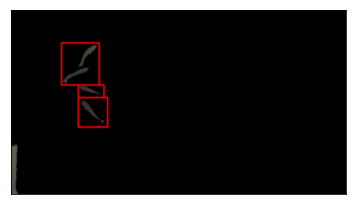

321 done


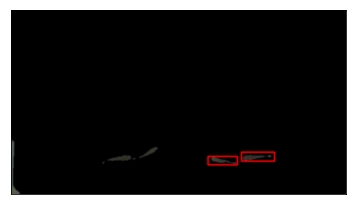

322 done


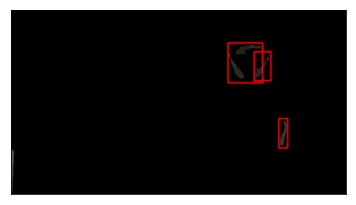

323 done


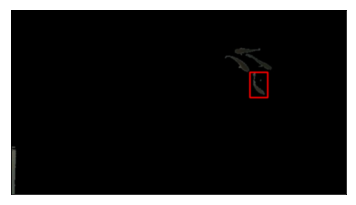

324 done


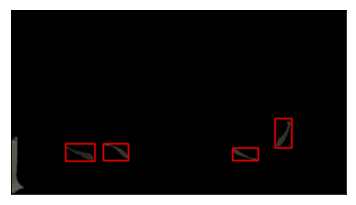

325 done


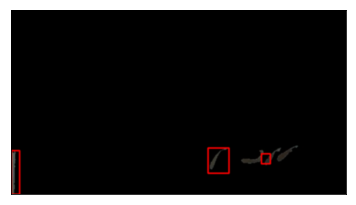

326 done


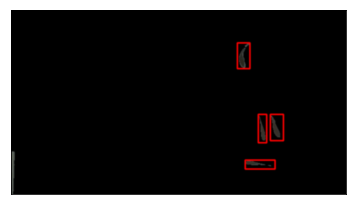

327 done


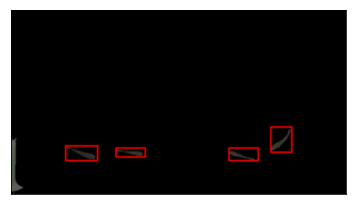

328 done


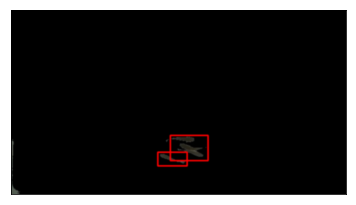

329 done


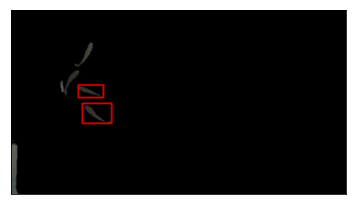

330 done


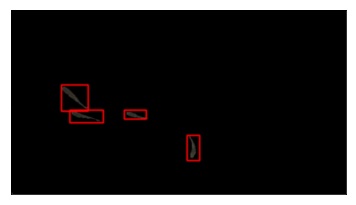

331 done


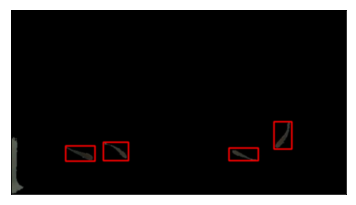

332 done


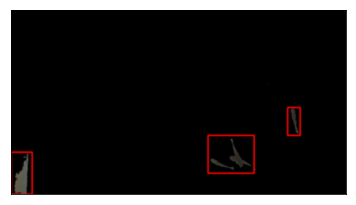

333 done


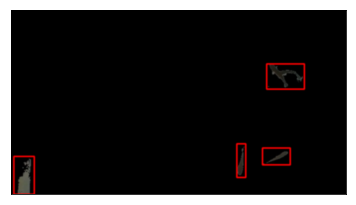

334 done


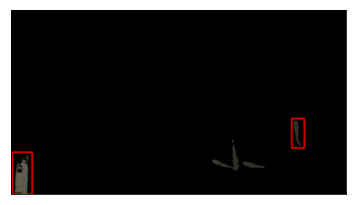

335 done


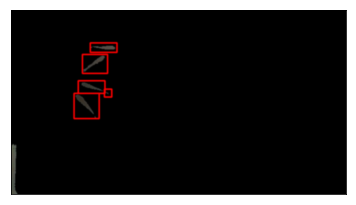

336 done


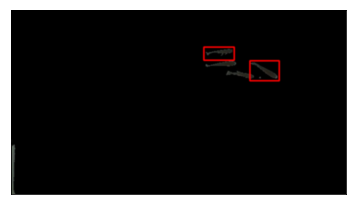

337 done


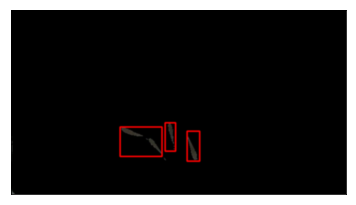

338 done


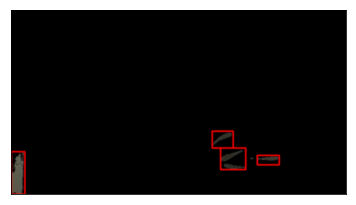

339 done


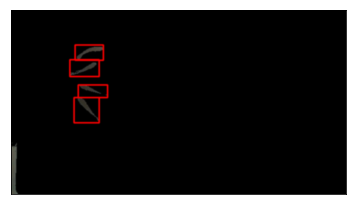

340 done


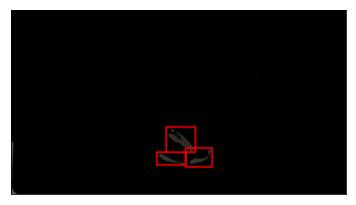

341 done


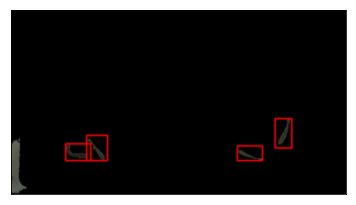

342 done


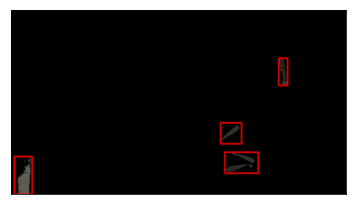

343 done


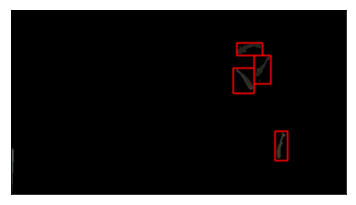

344 done


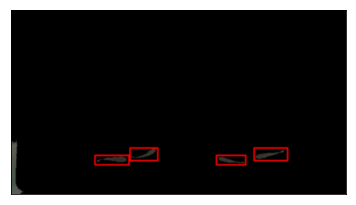

345 done


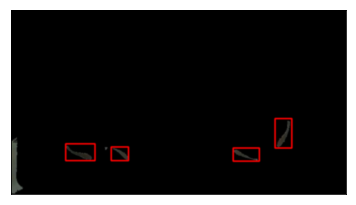

346 done


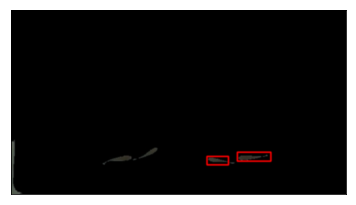

347 done


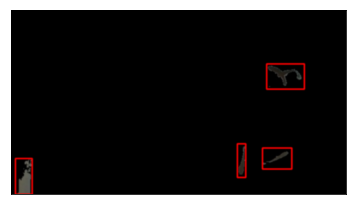

348 done


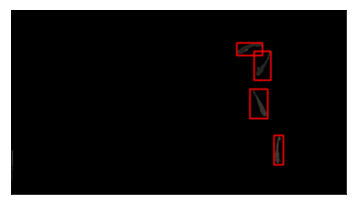

349 done


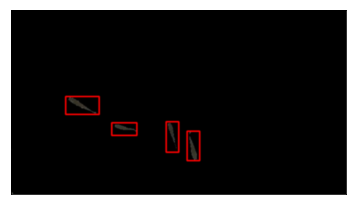

350 done


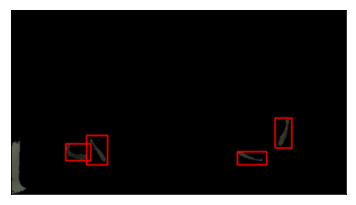

351 done


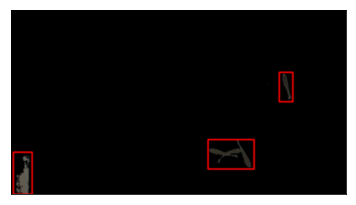

352 done


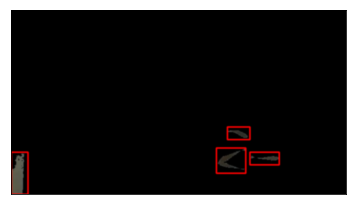

353 done


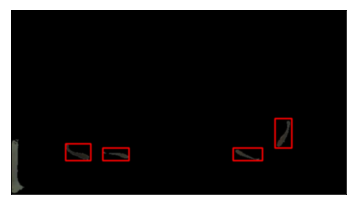

354 done


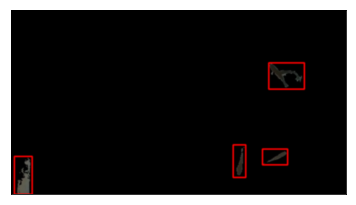

355 done


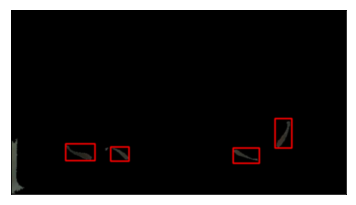

356 done


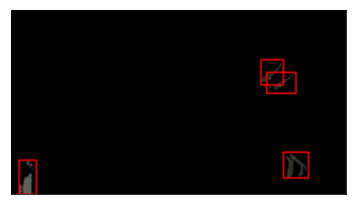

357 done


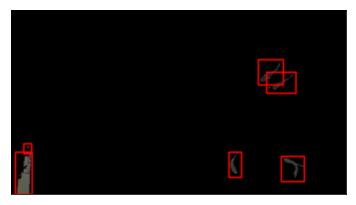

358 done


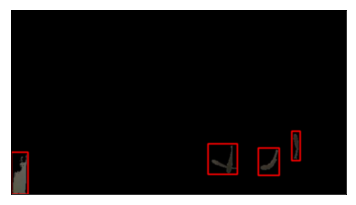

359 done


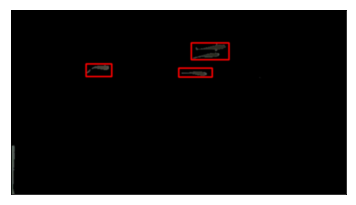

360 done


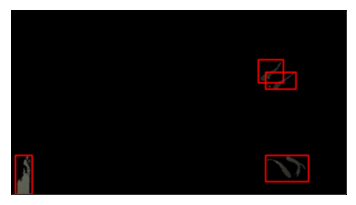

361 done


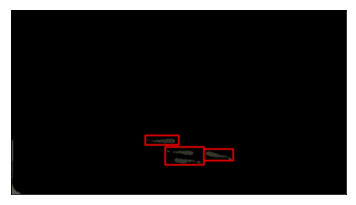

362 done


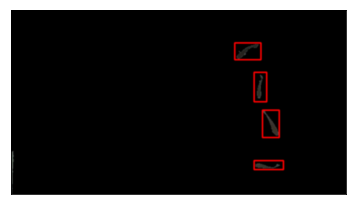

363 done


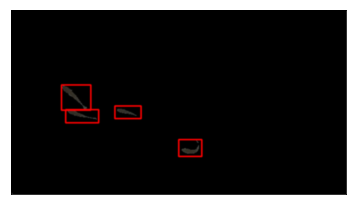

364 done


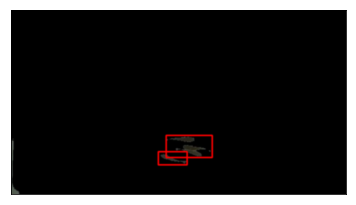

365 done


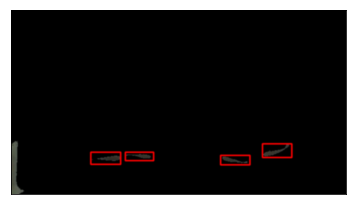

366 done


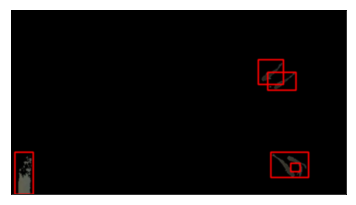

367 done


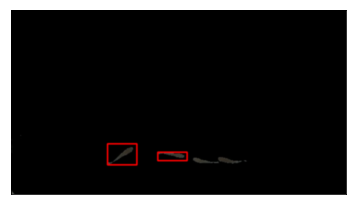

368 done


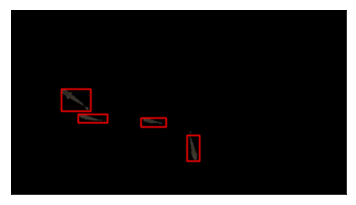

369 done


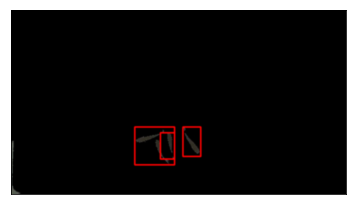

370 done


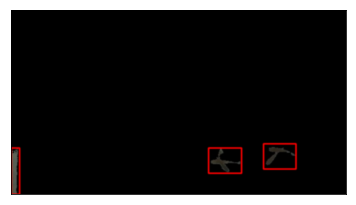

371 done


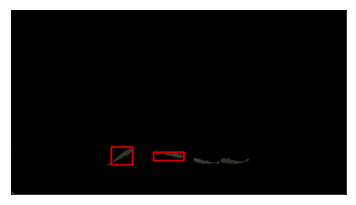

372 done


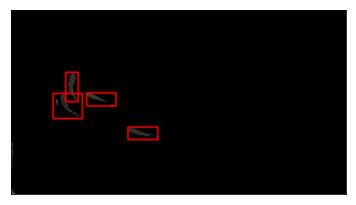

373 done


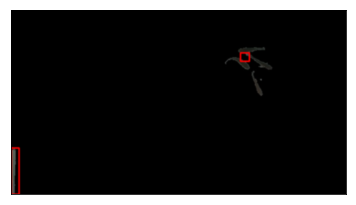

374 done


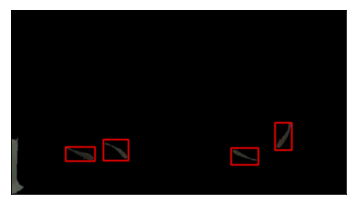

375 done


In [0]:
for i in range(len(grey)):
  
  im = cv2.imread('/content/geryimages/'+grey[i])

  canny_img = im
  imgray = cv2.cvtColor(im,cv2.COLOR_BGR2GRAY)
  ret,thresh = cv2.threshold(imgray,100,100,100)
  #im2, contours, hierarchy = cv2.findContours(canny_img,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
  #ret,thresh = cv2.threshold(im,100,100,100)
  im2, contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)


  try: hierarchy = hierarchy[0]
  except: hierarchy = []

  height, width, _ = canny_img.shape
  min_x, min_y = width, height
  max_x = max_y = 0

  # computes the bounding box for the contour, and draws it on the frame,
  for contour, hier in zip(contours, hierarchy):
      (x,y,w,h) = cv2.boundingRect(contour)
      #print(x,y,w,h)
      min_x, max_x = min(x, min_x), max(x+w, max_x)
      min_y, max_y = min(y, min_y), max(y+h, max_y)
      if w > 12 and h > 12 and w<90 and h<90 :
          cv2.rectangle(canny_img, (x,y), (x+w,y+h), (255, 0, 0), 2)

  #if max_x - min_x > 12 and max_y - min_y > 12:

   #   cv2.rectangle(canny_img, (min_x, min_y), (max_x, max_y), (255, 255, 0), 2)

  plt.imshow(canny_img, cmap = 'gray', interpolation = 'bicubic')
  plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
  plt.show()
  cv2.imwrite('/content/contours/contours'+grey[i],canny_img)
  #print('/content/contours/contours'+i)
  print(i,"done")

In [0]:
!zip -r contours.zip /content/contours

  adding: content/contours/ (stored 0%)
  adding: content/contours/contoursgrey06frame294.jpg (deflated 41%)
  adding: content/contours/contoursgrey06frame524.jpg (deflated 39%)
  adding: content/contours/contoursgrey06frame255.jpg (deflated 52%)
  adding: content/contours/contoursgrey06frame757.jpg (deflated 37%)
  adding: content/contours/contoursgrey06frame390.jpg (deflated 37%)
  adding: content/contours/contoursgrey06frame318.jpg (deflated 39%)
  adding: content/contours/contoursgrey06frame581.jpg (deflated 45%)
  adding: content/contours/contoursgrey06frame837.jpg (deflated 34%)
  adding: content/contours/contoursgrey06frame285.jpg (deflated 45%)
  adding: content/contours/contoursgrey06frame745.jpg (deflated 38%)
  adding: content/contours/contoursgrey06frame66.jpg (deflated 38%)
  adding: content/contours/contoursgrey06frame181.jpg (deflated 42%)
  adding: content/contours/contoursgrey06frame639.jpg (deflated 39%)
  adding: content/contours/contoursgrey06frame831.jpg (deflated 

In [0]:
os.listdir('/content/contours')

In [0]:
!zip -r grey.zip /content/geryimages

  adding: content/geryimages/ (stored 0%)
  adding: content/geryimages/grey06frame815.jpg (deflated 36%)
  adding: content/geryimages/grey06frame181.jpg (deflated 57%)
  adding: content/geryimages/grey06frame795.jpg (deflated 45%)
  adding: content/geryimages/grey06frame561.jpg (deflated 52%)
  adding: content/geryimages/grey06frame424.jpg (deflated 49%)
  adding: content/geryimages/grey06frame770.jpg (deflated 47%)
  adding: content/geryimages/grey06frame688.jpg (deflated 47%)
  adding: content/geryimages/grey06frame871.jpg (deflated 46%)
  adding: content/geryimages/grey06frame855.jpg (deflated 45%)
  adding: content/geryimages/grey06frame580.jpg (deflated 52%)
  adding: content/geryimages/grey06frame287.jpg (deflated 53%)
  adding: content/geryimages/grey06frame350.jpg (deflated 53%)
  adding: content/geryimages/grey06frame474.jpg (deflated 51%)
  adding: content/geryimages/grey06frame564.jpg (deflated 53%)
  adding: content/geryimages/grey06frame785.jpg (deflated 45%)
  adding: con